# Synthetic Quantum Electrodynamics via Generative AI
# Part III/V -- Surrogate Simulator

$
\large
\text{Mikael Mieskolainen}
$

$
\text{Department of Physics and I-X Centre for AI in Science, Imperial College London}
$

$
\tiny
\texttt{m.mieskolainen@imperial.ac.uk}
$

<a href="https://github.com/mieskolainen">github.com/mieskolainen</a>

<br>

$
\text{May, 2025}
$

**Abstract**

We use a QED Monte Carlo event generator to generate training data and train conditional normalizing flows and diffusion models as fast **surrogate simulators** of the data density $p(\mathbf{x} \mid \mathbf{\theta})$, where $x$ denotes the multidimensional final-state observables and $\mathbf{\theta} = \sqrt{s}$ is the conditional variable (center-of-mass energy). This quantity corresponds to the likelihood term in Bayes’ formula. In this notebook, we focus on benchmarking the generative model quality, without performing statistical parameter inference. In the next notebook, we do the *inverse*, learn $p(\theta \mid \mathbf{x})$.

<br>
<br>

**Outline:**

- [Part I: Physics Theory](tutorial_part_1.ipynb)
- [Part II: AI Theory](tutorial_part_2.ipynb)
- [Part III: Surrogate Simulator](tutorial_part_3.ipynb)
- [Part IV: Amortized Bayesian Posterior](tutorial_part_4.ipynb)
- [Part V: Deep Inverse Problems](tutorial_part_5.ipynb)

<br>

<div style="display: flex; flex-wrap: wrap; justify-content: space-between; gap: 10px;">
  <img src="img/scattering_simulation.jpeg" style="width: 49%; height: auto;">
  <img src="img/OU_simulation.jpeg" style="width: 49%; height: auto;">
</div>


> **Compatibility: Use VSCode with Jupyter extension (better LaTex rendering) or JupyterLab. Hit refresh [F5] if the notebook freezes.**


<br>

---

$
\boxed{
    \text{Rough Guidelines}
}
$

1. Always test with a **toy problem** first (e.g. a Gaussian mixture with a known pdf), verify that both sampling and pdf evaluation code works
2. Try to scan all major hyperparameters (model and training scheme), to avoid e.g. **double descent** like bad phase transition regimes in the hyperparameter space
3. Study **physics inspired**, constrained, equivariant, symmetry driven network architectures and pre-processing (but sometimes e.g. equivariance may hurt)
4. **Scale up**, deep learning starts to work with plenty of data and GPU power (cf. neural scaling laws)


In [ ]:
%load_ext autoreload
%autoreload 2

In [ ]:
# Run this first if using Colab
"""
!git clone https://github.com/mieskolainen/AIMS25.git
%cd AIMS25
"""
import sys
sys.path.append('./xaims')

# !pip install -r requirements.txt

In [2]:
import torch
import numpy as np
import torch.optim as optim

# For reproducibility
seed = 42
np.random.seed(seed)
torch.manual_seed(seed)

# Use device: GPU if available
if torch.cuda.is_available():
    device = torch.device("cuda:0")
    !nvidia-smi
else:
    device = torch.device("cpu")

print("Using device:", device)

Mon Apr 28 01:21:04 2025       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 525.125.06   Driver Version: 525.125.06   CUDA Version: 12.0     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  NVIDIA A100-SXM...  On   | 00000000:17:00.0 Off |                    0 |
| N/A   29C    P0    60W / 500W |      3MiB / 81920MiB |      0%      Default |
|                               |                      |             Disabled |
+-------------------------------+----------------------+----------------------+
|   1  NVIDIA A100-SXM...  On   | 00000000:31:00.0 Off |                    0 |
| N/A   

<br>

---
## Generate Training Data with Monte Carlo Event Generator

[xaims/qedgen.py](xaims/qedgen.py)

We generate training data with different CM energies $\sqrt{s}$, in order to train a conditional generative models $\mathbf{x} \sim p(\mathbf{x} \mid \sqrt{s})$.

In [3]:
from xaims import qedgen

# -------------------------------------------------------------------------------------------
n_events_per_s = int(2e4)  # number of events, O(1e6)++ starts to be robust

# CM energies
# (it would be better to vary this continuously,
#  but for the interpolation test purposes, we stick to a discrete set of values)
sqrts_train_values = np.array([1.0, 1.25, 1.5, 1.75, 2.0])
# -------------------------------------------------------------------------------------------

# -------------------------------------------------------------------------------------------
# Fiducial cut of our detector (geometric acceptance)

theta_min_fiducial = np.deg2rad(20.0)    # all functions use radians
theta_max_fiducial = np.deg2rad(160.0)

print(f'Fiducial cuts:')
print(f'theta    = [{np.rad2deg(theta_min_fiducial):0.2f}, {np.rad2deg(theta_max_fiducial):0.2f}] deg')
print(f'costheta = [{np.cos(theta_max_fiducial):0.2f}, {np.cos(theta_min_fiducial):0.2f}]) \n')
# -------------------------------------------------------------------------------------------

mc_events     = []
mc_conditions = []

for sqrts in sqrts_train_values:
    
    s = sqrts**2
    
    print(f'sqrt(s) = {sqrts:0.1f} GeV')
    
    # Map angular cuts to Mandelstam t
    
    t_min = qedgen.costheta_to_t(costheta=np.cos(theta_max_fiducial), s=s)
    t_max = qedgen.costheta_to_t(costheta=np.cos(theta_min_fiducial), s=s)
    
    t_min = max(t_min, -(s - 4*qedgen.m_e**2)) # kinematic limit
    
    # Generate events
    x, xs, xs_err, unweight_eff = \
        qedgen.generator(num_events=n_events_per_s, sqrts=sqrts, t_min=t_min, t_max=t_max, theory=qedgen.Mode.QED_bhabha)
    
    mc_events.append(x)
    mc_conditions.append(np.full((n_events_per_s, 1), sqrts))
    
    # Conversion to microbarns
    xs, xs_err = xs*qedgen.nat2ub, xs_err*qedgen.nat2ub
    
    print(f'Fiducial cuts: t = [{t_min:0.3f}, {t_max:0.3f}] GeV^2')
    print(f"Integrated Fiducial Cross-Section")
    print(f"{xs:0.4f} +- {xs_err:0.4f} ubarn ({xs_err / xs * 100:0.1f} %) | unweighting efficiency: {unweight_eff:0.1E} \n")

mc_events     = np.concatenate(mc_events, axis=0)
mc_conditions = np.concatenate(mc_conditions, axis=0)

# Convert training data to tensors
x_tensor = torch.tensor(mc_events,     dtype=torch.float32).to(device)
c_tensor = torch.tensor(mc_conditions, dtype=torch.float32).to(device)

print(f"Training data: x.shape = {x_tensor.shape}, c.shape = {c_tensor.shape}")


Fiducial cuts:
theta    = [20.00, 160.00] deg
costheta = [-0.94, 0.94]) 

sqrt(s) = 1.0 GeV
Fiducial cuts: t = [-0.970, -0.030] GeV^2
Integrated Fiducial Cross-Section
7.0975 +- 0.0292 ubarn (0.4 %) | unweighting efficiency: 2.8E-02 

sqrt(s) = 1.2 GeV
Fiducial cuts: t = [-1.515, -0.047] GeV^2
Integrated Fiducial Cross-Section
4.5464 +- 0.0186 ubarn (0.4 %) | unweighting efficiency: 2.8E-02 

sqrt(s) = 1.5 GeV
Fiducial cuts: t = [-2.182, -0.068] GeV^2
Integrated Fiducial Cross-Section
3.1579 +- 0.0128 ubarn (0.4 %) | unweighting efficiency: 2.8E-02 

sqrt(s) = 1.8 GeV
Fiducial cuts: t = [-2.970, -0.092] GeV^2
Integrated Fiducial Cross-Section
2.3391 +- 0.0096 ubarn (0.4 %) | unweighting efficiency: 2.8E-02 

sqrt(s) = 2.0 GeV
Fiducial cuts: t = [-3.879, -0.121] GeV^2
Integrated Fiducial Cross-Section
1.7943 +- 0.0073 ubarn (0.4 %) | unweighting efficiency: 2.8E-02 

Training data: x.shape = torch.Size([100000, 3]), c.shape = torch.Size([100000, 1])


<br>

---

## Neural Network Training

[xaims/transforms.py](aimsix/transforms.py) | [xaims/aux.py](aimsix/aux.py)

### Preprocessing of training data

**Preprocessing of data can be crucial:**

- Normalizing flows cannot handle well e.g. large scale differences, thus $z$-score standardization is typically done. It also improves neural network training in general.

- Constant variables cause singular Jacobian structure for the flow, thus they should not appear in the $x$-space.

- Even mildly discrete $x$-space variables require typically *dequantization*, e.g. adding engineered noise to the training set, otherwise flow can start to fit Dirac deltas around the values.

- Some generative models may implicitly assume $z$-score standardized data target distributions.

### Physics driven transform

We do a physics based invertible feature mapping from the cartesian 3-momentum space to a mixed-embedded coordinate system:

$
(p_x, p_y, p_z) \rightarrow (p_T, p_z, \cos \phi, \sin \phi),
$

where we used $\phi \rightarrow (\cos \phi, \sin \phi)$ embedding to a circle $S^1 = \{(x,y) \in \mathbb{R}^2 \mid x^2 + y^2 = 1 \}$, because $\cos ^2\phi + \sin^2 \phi = 1$. Using raw $\phi$ would be modulo $2\pi$ (phase wraps over) and can make the optimization harder. See the transform functions for the discussion about the total Jacobian structure involved. Optionally, one can change `pz` to `eta` (pseudorapidity), or `pt` to `log_pt` (or `pt2`). 

Ultimately, the best set of transforms is motivated by a combination of physics and benchmarking. Remember that our process is dominantly forward scattering, i.e. large longitudinal momentum, small transverse.

After training, the chain of feature transforms is inverted. For evaluating density (likelihood) values in the original data space, the corresponding Jacobian of the transform needs to be taken into account.

In [4]:
from xaims import transforms

# We will learn pdf(x | c)

# -------------------------------------------------------------------
# Data x-space

# 1. Create physics coordinate transform and apply
geom_map_x     = transforms.PhysicsTransform(transverse_mode='pt', longitudinal_mode='pz').to(device)
x_tensor_norm  = geom_map_x.forward(x_tensor)

# 2. Create standardization transform and apply
zscore_map_x   = transforms.ZScoreTransform(x_tensor_norm.mean(dim=0, keepdim=True),
                                            x_tensor_norm.std(dim=0, keepdim=True)).to(device)
x_tensor_norm  = zscore_map_x.forward(x_tensor_norm)

# 3. Chain to a total transform map to reverse later in the inference
pre_transform_x  = transforms.CompositeTransform([geom_map_x, zscore_map_x]).to(device)

#pre_transform_x = transforms.CompositeTransform([]).to(device) # To deactivate, use this and comment out all above
# -------------------------------------------------------------------

# -------------------------------------------------------------------
# Conditional c-space

# 1. Create standardization transform and apply
zscore_map_c = transforms.ZScoreTransform(c_tensor.mean(dim=0, keepdim=True),
                                          c_tensor.std(dim=0, keepdim=True)).to(device)
c_tensor_norm = zscore_map_c.forward(c_tensor)

# 2. Add to the composite
pre_transform_c = transforms.CompositeTransform([zscore_map_c]).to(device)

#pre_transform_c = transforms.CompositeTransform([]).to(device) # To deactivate, use this and comment out all above
# -------------------------------------------------------------------

x_dim   = x_tensor_norm.shape[-1]
c_dim   = c_tensor_norm.shape[-1]


### Adam(W) optimizer

We use AdamW by default, because it decouples the $L_2$ (weight decay) regularizer from the gradient update and typically achieves better performance.

<details>
<summary><span style="color: red">Details about Adam (expand)</span></summary>

<br>

**Adam** (Adaptive Moment Estimation) is an optimization algorithm that combines momentum and adaptive learning rates. It is widely used for training deep neural networks, including flow models.

---

#### Hyperparameters

- $ \alpha $: learning rate (e.g. $ 0.001 $)
- $ \beta_1 $: exponential decay rate for the 1st moment estimate (e.g. $ 0.9 $)
- $ \beta_2 $: exponential decay rate for the 2nd moment estimate (e.g. $ 0.999 $)
- $ \varepsilon $: small constant for numerical stability (e.g. $ 10^{-8} $)

---

#### Iterative Update Rules

Given gradient $ g_t = \nabla_\theta \mathcal{L}(\theta_t) $, update the parameters $ \theta $ as follows:

1. **Gradient of the loss**:
$
g_t = \nabla_\theta \mathcal{L}(\theta_t)
$

2. **First moment estimate (mean)**:
$
m_t = \beta_1 m_{t-1} + (1 - \beta_1) g_t
$

3. **Second moment estimate (variance)**:
$
v_t = \beta_2 v_{t-1} + (1 - \beta_2) g_t^2
$

4. **Bias correction**:
$
\hat{m}_t = \frac{m_t}{1 - \beta_1^t}, \quad 
\hat{v}_t = \frac{v_t}{1 - \beta_2^t}
$

5. **Parameter update**:
$
\boxed{
\theta_{t+1} = \theta_t - \alpha \cdot \frac{\hat{m}_t}{\sqrt{\hat{v}_t} + \varepsilon}
}
$

---

#### Additional notes

- $ g_t^2 $ is applied **elementwise**: $ (g_t)^2 \equiv g_t \odot g_t $
- Bias correction has effect especially in early iterations
- Adam combines the benefits of:
  - **Momentum** (via $ m_t $)
  - **Adaptive step sizes** (via $ v_t $)

The memory consumption of Adam ($m$ and $v$), becomes a critical issue with large scale models. Training in total takes then typically about 3x times more memory than the inference.

</details>

### Train coupling based Normalizing Flows

The flow is trained to maximize the log–likelihood: $\ln L = \sum_i \log p(\mathbf{x}_i)$ of our training data, by minimizing the negative log–likelihood.


CouplingFlow: using flow_type = spline with flow_layers = 4 and permute = True
Number of model parameters: 1.0E+05


Training: 100%|████████████████████████████████████████| 300/300 [16:54<00:00,  3.38s/epoch, train_loss=-4.1742, lr=0.000500, val_loss=-4.4131]


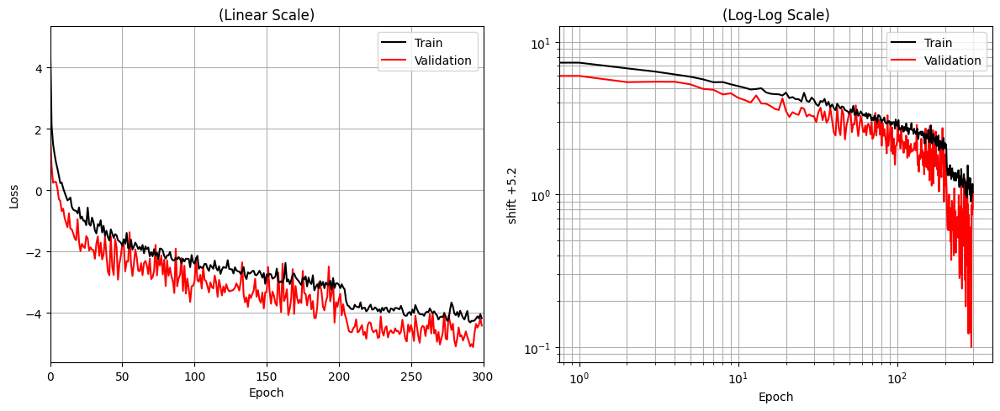

In [5]:
from xaims import flows, aux, visualize

n_epochs   = 300
batch_size = 2048

# Create dataloaders
train_loader, val_loader = aux.split_loaders(x_tensor_norm, c_tensor_norm, frac=0.8, batch_size=batch_size)

learning_rate_flow = 1e-3
weight_decay       = 1e-5

model_flow      = flows.CouplingFlow(
    x_dim       = x_dim,
    cond_dim    = c_dim,
    flow_layers = 4,
    flow_type   = "spline",
    permute     = True,
    nn_param    = [{"hidden_dim": [96, 96], "layer_norm": True, "act": "silu", "dropout": 0.01},
                   {"hidden_dim": [96, 96], "layer_norm": True, "act": "silu", "dropout": 0.01}]
).to(device)

# Optimizer and Scheduler
optimizer_flow = optim.AdamW(model_flow.parameters(), lr=learning_rate_flow, weight_decay=weight_decay)
scheduler_flow = optim.lr_scheduler.ReduceLROnPlateau(optimizer_flow, 'min', factor=0.5, patience=20, min_lr=1e-5)

# Returns the best validation loss model
losses_flow, model_flow = aux.train_wrapper(model=model_flow, optimizer=optimizer_flow, scheduler=scheduler_flow,
                                  train_loader=train_loader, val_loader=val_loader, n_epochs=n_epochs)

fix,axs = visualize.plot_losses(train_losses=losses_flow[0], val_losses=losses_flow[1])


### Train DDPM Diffusion Model

The network inside the model is trained to predict the added noise vector $\mathbf{\epsilon}$.

Number of model parameters: 2.1E+04


Training: 100%|██████████████████████████████████████████| 200/200 [04:16<00:00,  1.28s/epoch, train_loss=0.6460, lr=0.000010, val_loss=0.6387]


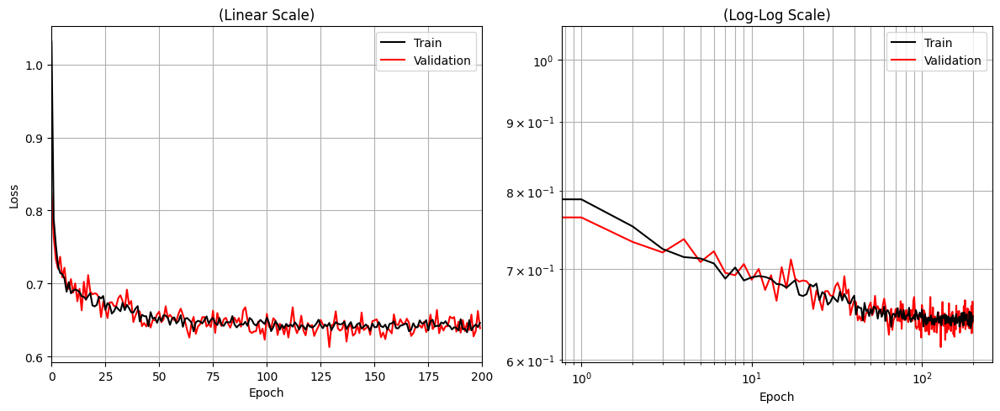

In [6]:
from xaims import ddpm, aux, visualize

n_epochs   = 200
batch_size = 256

# Create dataloaders
train_loader, val_loader = aux.split_loaders(x_tensor_norm, c_tensor_norm, frac=0.8, batch_size=batch_size)

lr              = 1e-3
weight_decay    = 1e-3

time_embed_dim  = 8
model_ddpm = ddpm.DDPM(
    x_dim           = x_dim,
    cond_dim        = c_dim,
    beta_start      = 1e-4,
    beta_end        = 0.02,
    diffusion_steps = 1000,
    time_embed_dim  = 8,
    nnet            = aux.ResidualMLP(in_dim=x_dim + time_embed_dim + c_dim, out_dim=x_dim,
                               **{"hidden_dim": [96, 96, 96], "layer_norm": True, "act": "silu", "dropout": 0})
    #nnet           = aux.VectorTransformer(in_dim=x_dim + time_embed_dim + c_dim, out_dim=x_dim,
    #                           **{"d_model": 32, "nhead": 4, "num_layers": 2, "dim_feedforward": 128, "dropout": 0.0})
).to(device)

# Optimizer and scheduler
optimizer_ddpm = optim.AdamW(model_ddpm.parameters(), lr=lr, weight_decay=weight_decay)
scheduler_ddpm = optim.lr_scheduler.ReduceLROnPlateau(optimizer_ddpm, 'min', factor=0.5, patience=10, min_lr=1e-5)

# Returns the best validation loss model
losses_ddpm, model_ddpm = aux.train_wrapper(model=model_ddpm, optimizer=optimizer_ddpm, scheduler=scheduler_ddpm,
                                  train_loader=train_loader, val_loader=val_loader, n_epochs=n_epochs)

fix,axs = visualize.plot_losses(train_losses=losses_ddpm[0], val_losses=losses_ddpm[1])


### Train Score Matching based SDE Diffusion

The network inside the model is trained to predict the data score vector $\nabla_{\mathbf{x}} \log p(\mathbf{x})$.

Number of model parameters: 2.1E+04


Training: 100%|██████████████████████████████████████████| 200/200 [04:29<00:00,  1.35s/epoch, train_loss=0.6540, lr=0.000010, val_loss=0.6233]


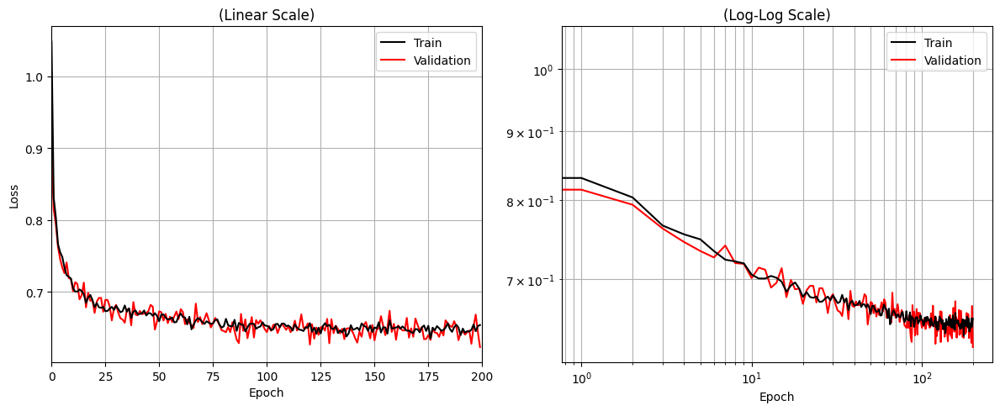

In [7]:
from xaims import sde, aux, visualize

lr           = 1e-3
weight_decay = 1e-3

n_epochs   = 200
batch_size = 256

# Create dataloaders
train_loader, val_loader = aux.split_loaders(x_tensor_norm, c_tensor_norm, frac=0.8, batch_size=batch_size)

# SDE model
time_embed_dim = 8
model_sde = sde.SDEModel(
    sde      = sde.VPSDE(beta_0=0.1, beta_1=20.0), 
    x_dim    = x_dim,
    cond_dim = c_dim,
    time_embed_dim = 8,
    loss_weighting = False,
    nnet     = aux.ResidualMLP(in_dim=x_dim + time_embed_dim + c_dim, out_dim=x_dim,
                               **{"hidden_dim": [96, 96, 96], "layer_norm": True, "act": "silu", "dropout": 0})
    #nnet    = aux.VectorTransformer(in_dim=x_dim + time_embed_dim + c_dim, out_dim=x_dim,
    #                           **{"d_model": 32, "nhead": 4, "num_layers": 2, "dim_feedforward": 128, "dropout": 0.0})
).to(device)

# Optimizer and scheduler
optimizer_sde = optim.AdamW(model_sde.parameters(), lr=lr, weight_decay=weight_decay)
scheduler_sde = optim.lr_scheduler.ReduceLROnPlateau(optimizer_sde, 'min', factor=0.5, patience=10, min_lr=1e-5)

# Returns the best validation loss model
losses_sde, model_sde = aux.train_wrapper(model=model_sde, optimizer=optimizer_sde, scheduler=scheduler_sde,
                                  train_loader=train_loader, val_loader=val_loader, n_epochs=n_epochs)

fix,axs = visualize.plot_losses(train_losses=losses_sde[0], val_losses=losses_sde[1])



<br>

---
## Generation and Visualization

In this section we compare the ground truth QED differential cross sections to the output from our generative models.

In [8]:
# Flow model sampler

from xaims import aux

def sample_from_flow(num_samples: int, cond: torch.Tensor, device='cpu'):
    
    model_flow.eval() #!

    with torch.no_grad():
        cond      = aux.expand_dim(cond, num_samples=num_samples, device=device) # Expand batch dimensions
        cond_norm = pre_transform_c.forward(cond) # Forward processing
        
        x         = model_flow.sample(num_samples, cond_norm)        
        samples   = pre_transform_x.reverse(x)    # Revert pre-processing

    return samples

def logprob_flow(x: torch.Tensor, cond: torch.Tensor, device='cpu'):
    
    model_flow.eval() #!

    with torch.no_grad():
        cond          = aux.expand_dim(cond, num_samples=x.shape[0], device=device) # Expand batch dimensions
        cond_norm     = pre_transform_c.forward(cond) # Forward processing
        
        x_norm, x_ldj = pre_transform_x.forward(x, return_logdet=True)
        
        log_prob      = model_flow.log_prob(x_norm, cond_norm)
        log_prob     += x_ldj # Add jacobian of pre-transform

    return log_prob



In [9]:
# DDPM diffusion model sampler

def sample_from_ddpm(num_samples: int, cond: torch.Tensor, device='cpu'):
    
    model_ddpm.eval() #!
    
    with torch.no_grad():
        cond      = aux.expand_dim(cond, num_samples=num_samples, device=device) # Expand batch dimensions
        cond_norm = pre_transform_c.forward(cond) # Forward processing
        
        x         = model_ddpm.sample(num_samples, cond_norm)        
        samples   = pre_transform_x.reverse(x)    # Revert pre-processing
    
    return samples



In [10]:
# SDE diffusion model sampler

def sample_from_sde(num_samples: int, cond: torch.Tensor, steps: int=1000, use_ode: bool=False, device='cpu'):
    
    model_sde.eval() #!
    
    with torch.no_grad():
        cond      = aux.expand_dim(cond, num_samples=num_samples, device=device) # Expand batch dimensions
        cond_norm = pre_transform_c.forward(cond) # Forward processing
        
        x         = model_sde.sample(num_samples, cond_norm, steps=steps, use_ode=use_ode)
        samples   = pre_transform_x.reverse(x)     # Revert pre-processing
    
    return samples

def logprob_sde(x: torch.Tensor, cond: torch.Tensor, steps: int=1000, exact: bool=True, n_hutchinson: int=5, device='cpu'):
    
    model_sde.eval() #!
    
    with torch.no_grad():
        cond          = aux.expand_dim(cond, num_samples=x.shape[0], device=device) # Expand batch dimensions
        cond_norm     = pre_transform_c.forward(cond) # Forward processing
        x_norm, ldj_x = pre_transform_x.forward(x, return_logdet=True)
        
        log_prob      = model_sde.log_prob(x_norm, cond_norm, steps=steps, exact=exact, n_hutchinson=n_hutchinson)
        log_prob     += ldj_x # Add jacobian of pre-transform
    
    return log_prob


### Comparison strategy in a nutshell

[xaims/visualize.py](xaims/visualize.py)

We compare the generated $d\sigma/dt, ...$ distributions versus the ground truth for several values of the CM energy $\sqrt{s}$:

- **Training $\sqrt{s}$** values as set above in the notebook
- **Interpolation/Extrapolation** in between the training sample $\sqrt{s}$ values (should be possible) and outside the range (not guaranteed)

**For each value of $\sqrt{s}$:**

1. Generate events from the ground truth MC generator
2. Generate events from the generative AI models
3. Compute observables and histogram, normalize histograms to obtain **differential cross sections** $d\sigma /dx$
4. Normalization is done by multiplying bin counts with the integrated fiducial cross section $\sigma_{tot}^{fid}$, and by dividing with the binwidth $\Delta x$
5. Compare with the ground truth

> **Note**: The integrated cross section is based on the MC generator ground truth. This could be fitted (trained) and predicted with AI also.

### Two sample comparison

**Single dimensional two sample tests:**

A reduced $\chi^2$-test statistic over 1D histogram $N$-bins is

$
\boxed{
\tilde{\chi}^2 \equiv \chi^2 / \text{ndf} = \frac{1}{N} \sum_{i=1}^N \left( \frac{n_i - \hat{n}_i}{\epsilon_i} \right )^2,
}
$

where $\hat{n}_i$ is the AI generated and $n_i$ is the MC event generator ground truth, both at the scale of bin entries (counts).
The word **reduced** means we have divided the test statistic by the number of bins $N$, for easier comparison.

This simple test statistic takes into account statistical fluctuations $\epsilon_i$ per bin. Typical choises are:

1. MC statistical: $\epsilon_i = \sqrt{n}_i$
2. AI statistical: $\epsilon_i = \sqrt{\hat{n}}_i$ 
3. MC $\oplus$ AI statistical: $\epsilon_i = \sqrt{n_i^2 + \hat{n}_i^2}$

Where $\sqrt{n}$ comes from the Poisson standard deviation. For weighted events, one sums the bin weights in quadrature to obtain $\epsilon^2 = \sum_i w_i^2$.

Original training set sqrt(s): [1.   1.25 1.5  1.75 2.  ] (GeV)
Inference test set sqrts(s): [0.75  1.    1.125 1.25  1.375 1.5   1.625 1.75  1.875 2.    3.   ] (GeV) 

** INTERPOLATION / EXTRAPOLATION over the conditional input **
Generating 10000 events for sqrt(s) = 0.75 GeV
QED (MC): 1143.0 kHz
Flow: 418.1 kHz
DDPM: 18.0 kHz
SDE: 15.7 kHz
SDE (ODE): 18.2 kHz


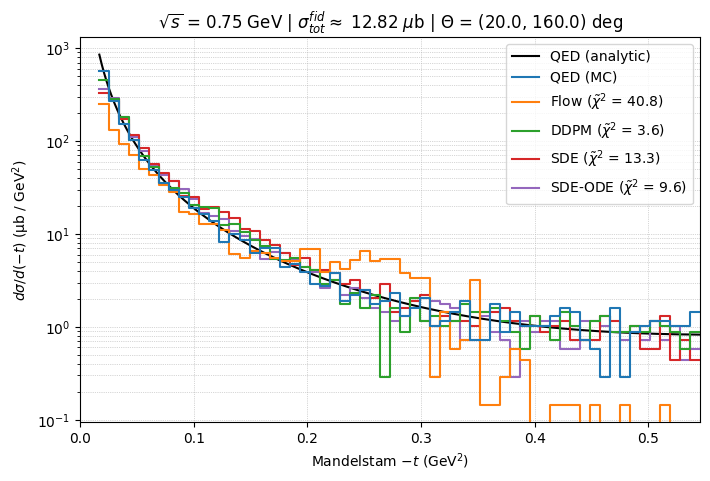

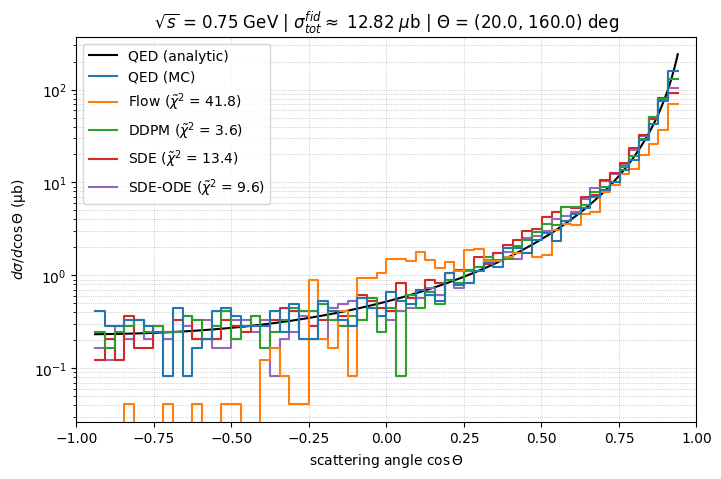

Flow logprob: 585.5 kHz
SDE logprob (exact grad): 34.1 kHz
SDE logprob (Hutchinson 1): 59.5 kHz
SDE logprob (Hutchinson 5): 17.4 kHz


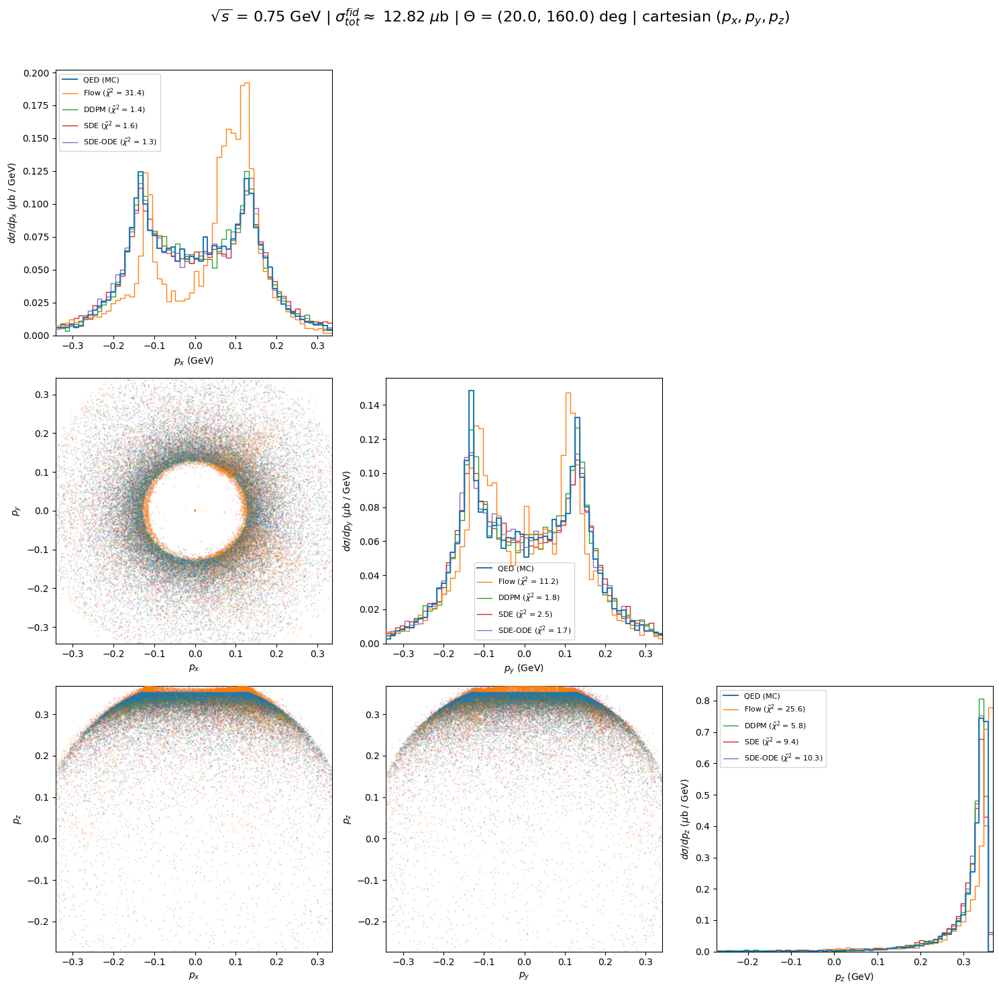

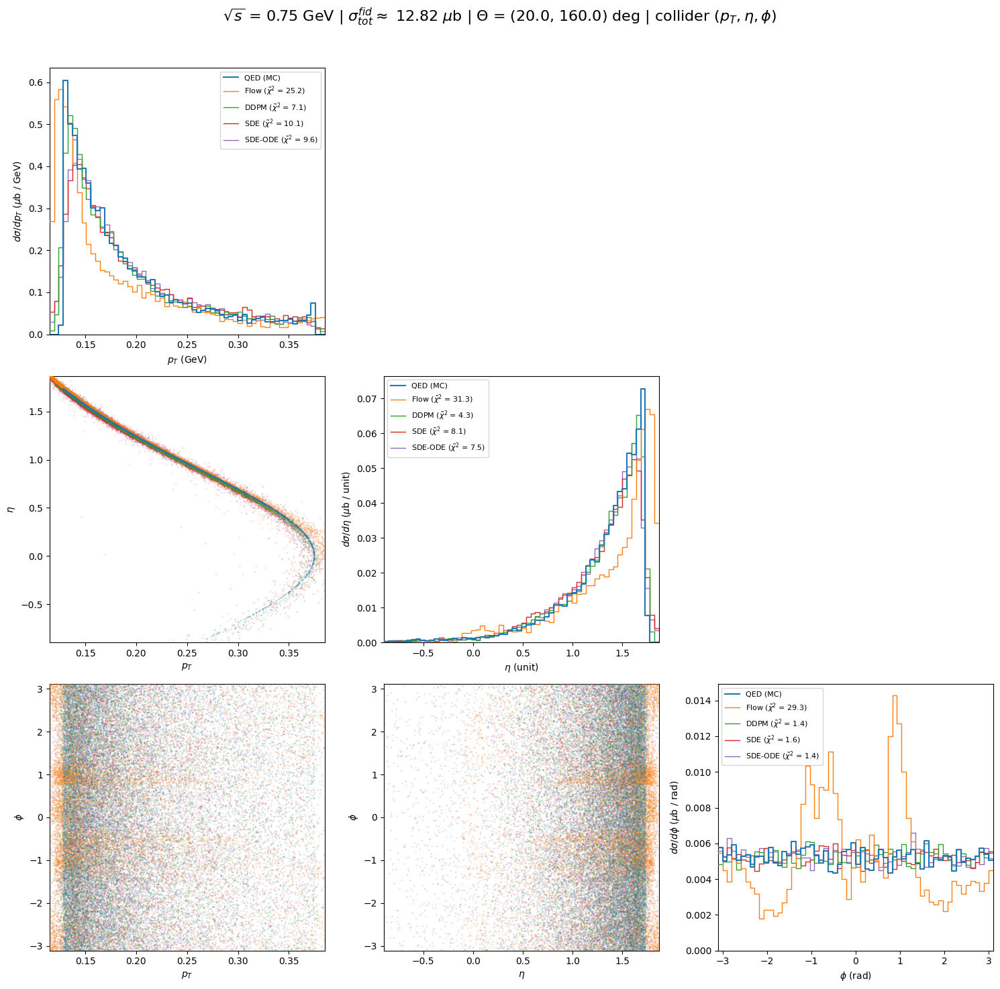

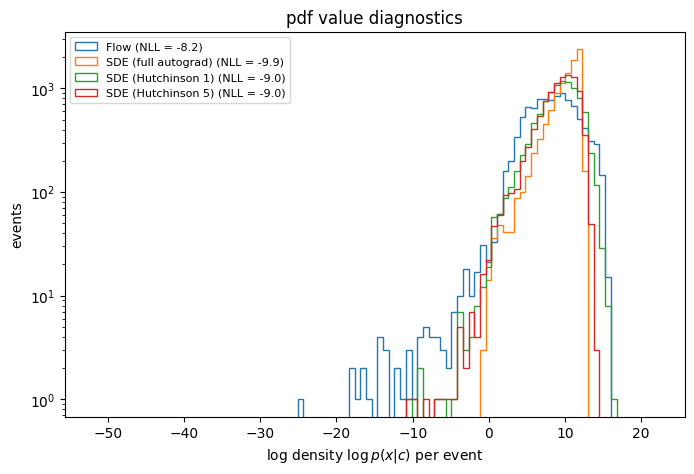

Generating 10000 events for sqrt(s) = 1.00 GeV
QED (MC): 1276.5 kHz
Flow: 538.1 kHz
DDPM: 17.9 kHz
SDE: 15.6 kHz
SDE (ODE): 18.0 kHz


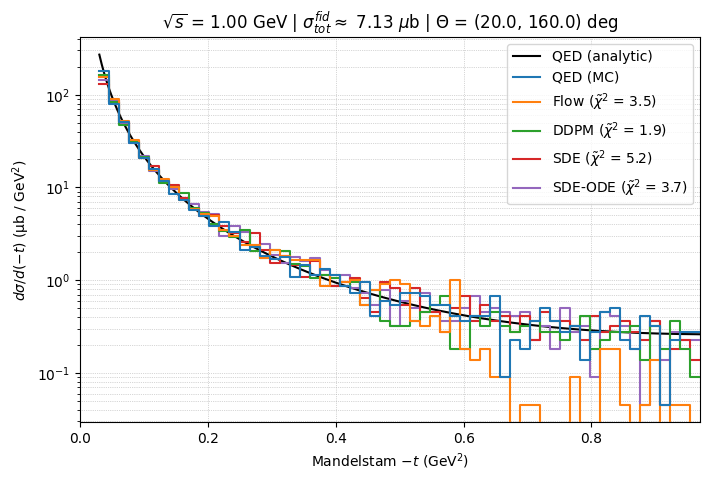

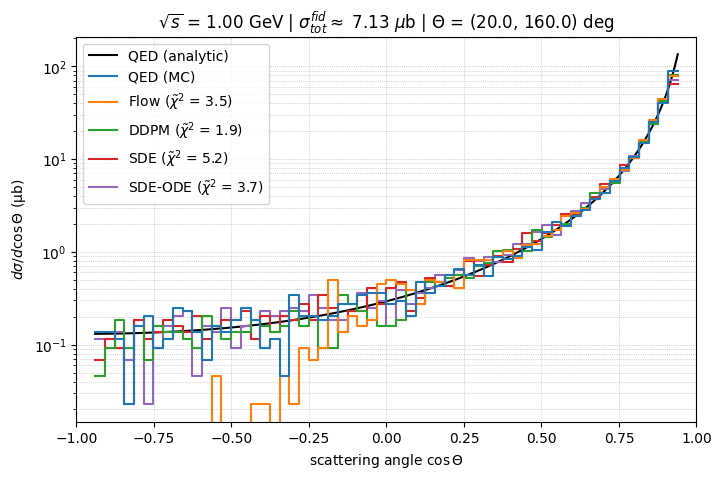

Flow logprob: 586.9 kHz
SDE logprob (exact grad): 35.4 kHz
SDE logprob (Hutchinson 1): 59.5 kHz
SDE logprob (Hutchinson 5): 17.3 kHz


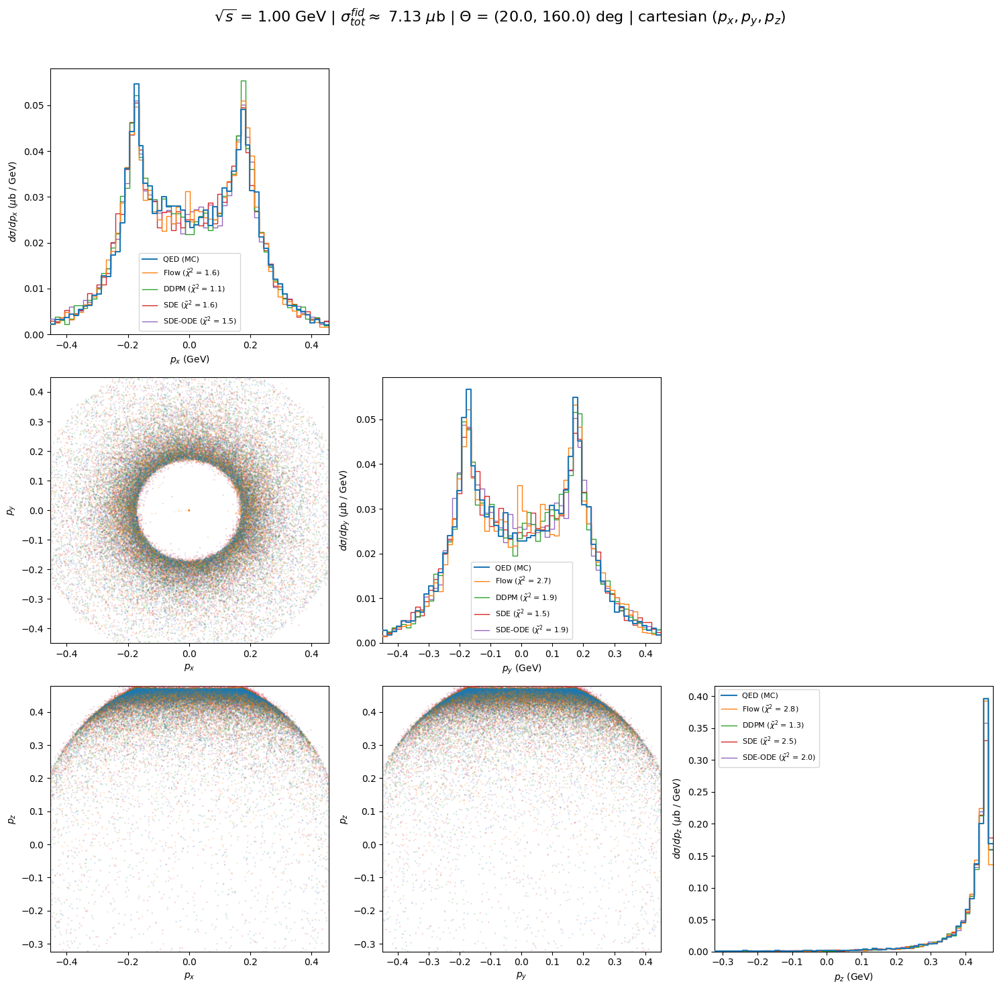

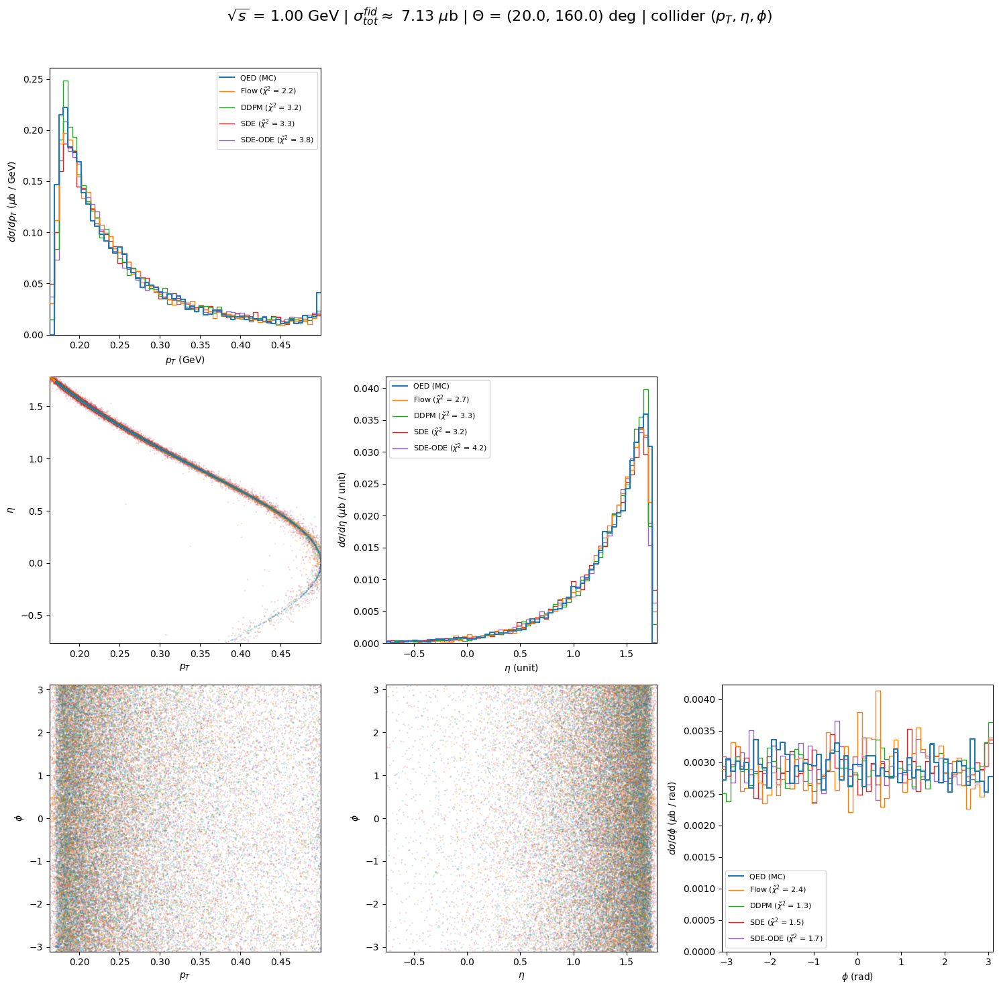

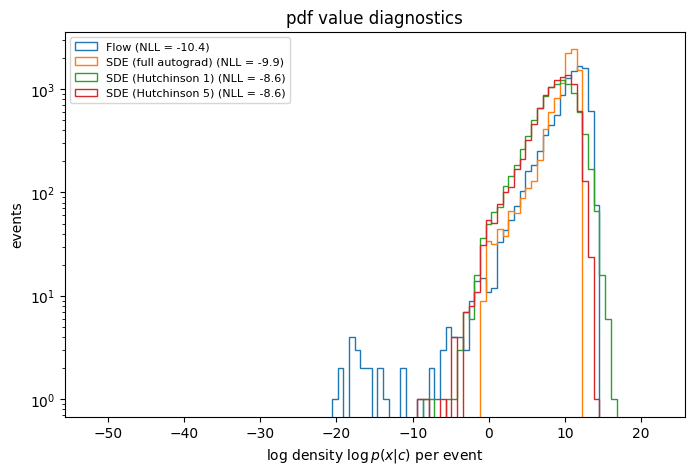

** INTERPOLATION / EXTRAPOLATION over the conditional input **
Generating 10000 events for sqrt(s) = 1.12 GeV
QED (MC): 1275.5 kHz
Flow: 536.5 kHz
DDPM: 17.9 kHz
SDE: 15.6 kHz
SDE (ODE): 18.0 kHz


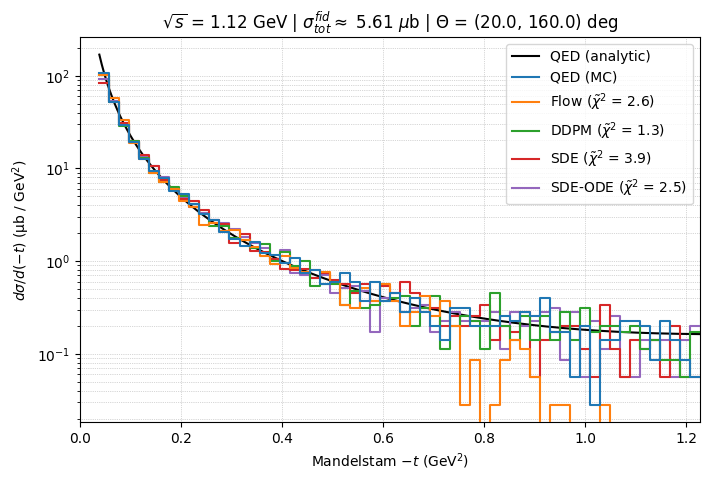

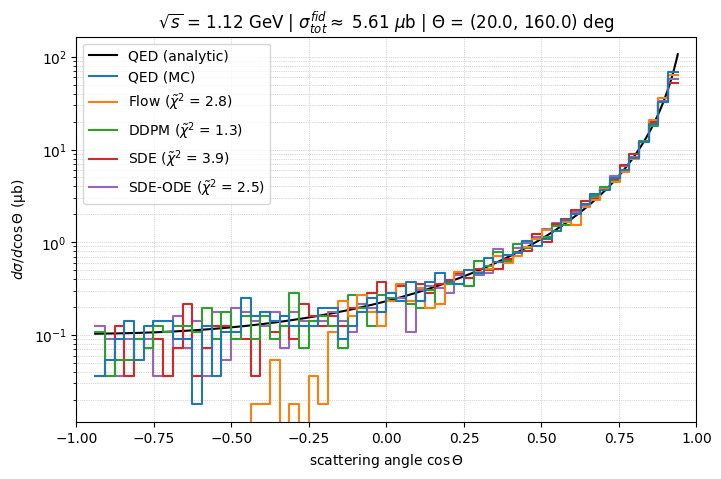

Flow logprob: 594.1 kHz
SDE logprob (exact grad): 35.7 kHz
SDE logprob (Hutchinson 1): 59.5 kHz
SDE logprob (Hutchinson 5): 17.4 kHz


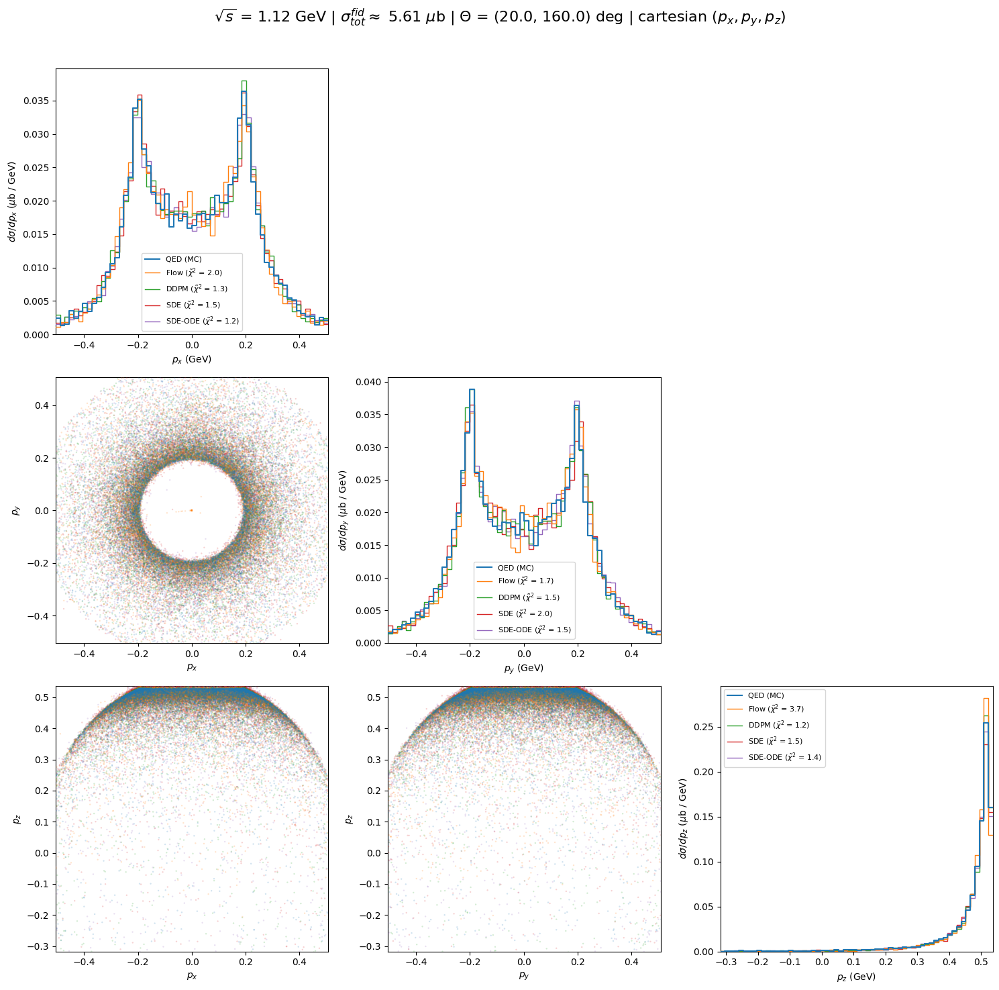

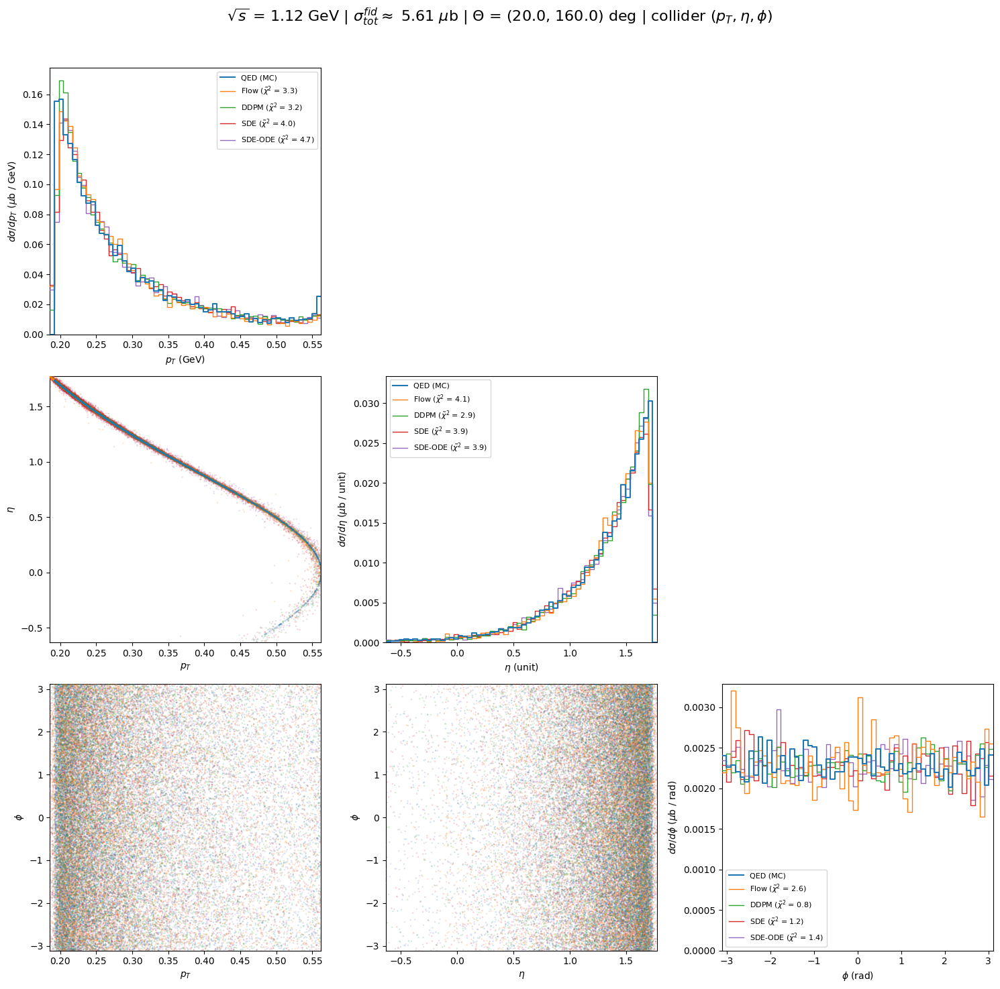

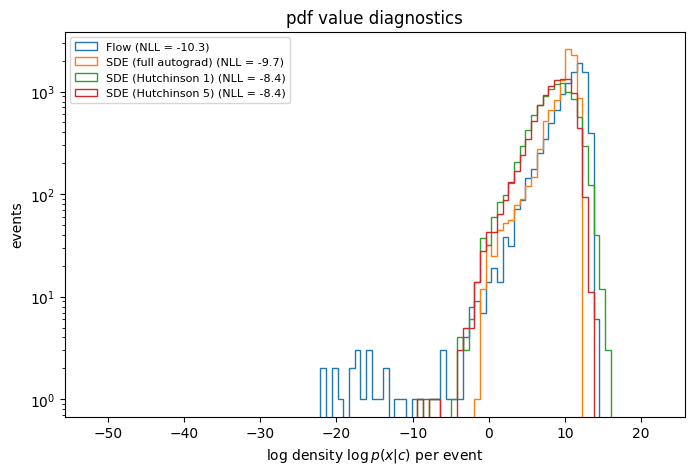

Generating 10000 events for sqrt(s) = 1.25 GeV
QED (MC): 1267.3 kHz
Flow: 539.9 kHz
DDPM: 17.9 kHz
SDE: 15.6 kHz
SDE (ODE): 18.0 kHz


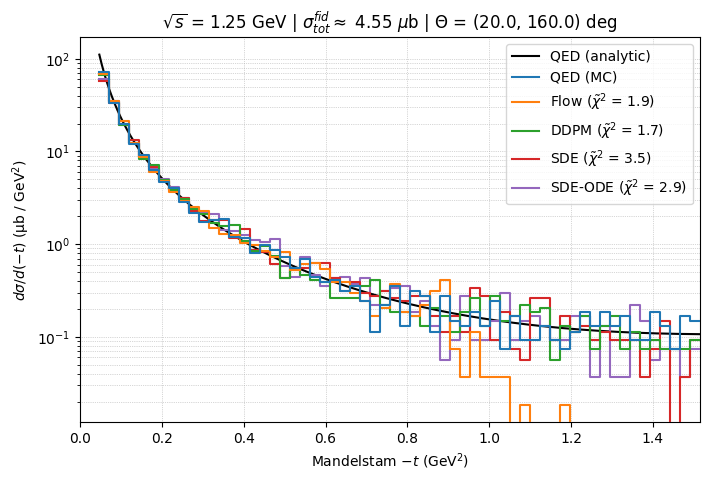

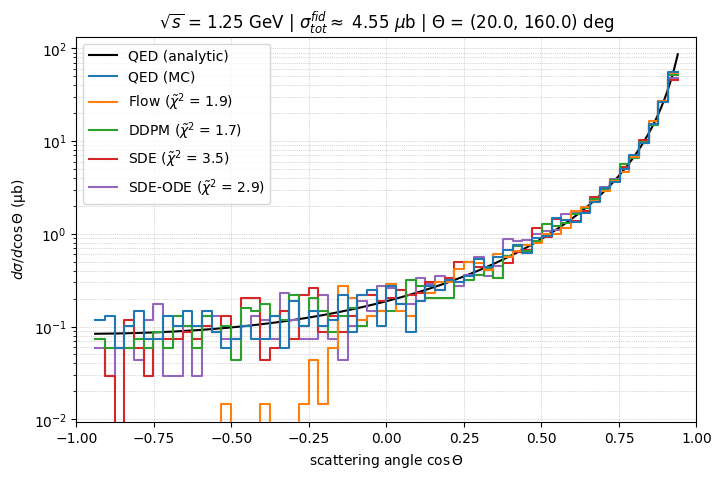

Flow logprob: 586.2 kHz
SDE logprob (exact grad): 35.6 kHz
SDE logprob (Hutchinson 1): 59.4 kHz
SDE logprob (Hutchinson 5): 17.3 kHz


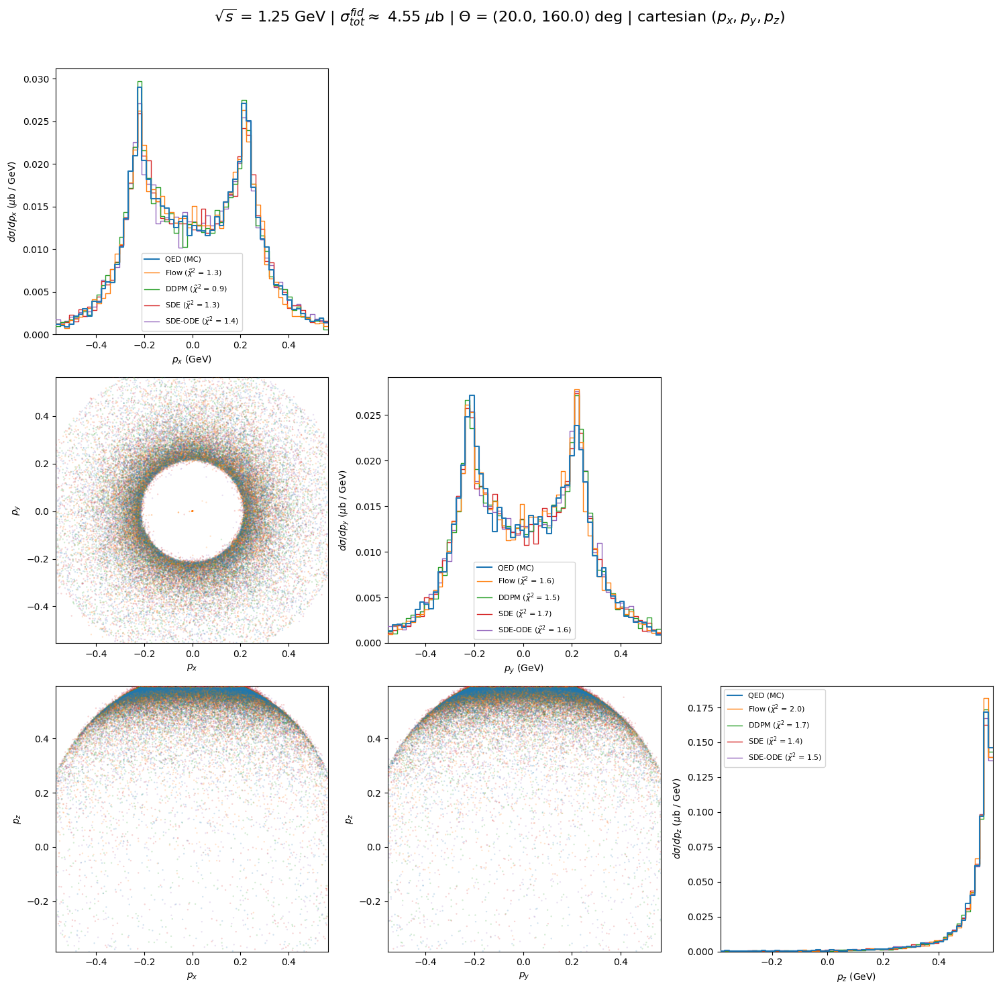

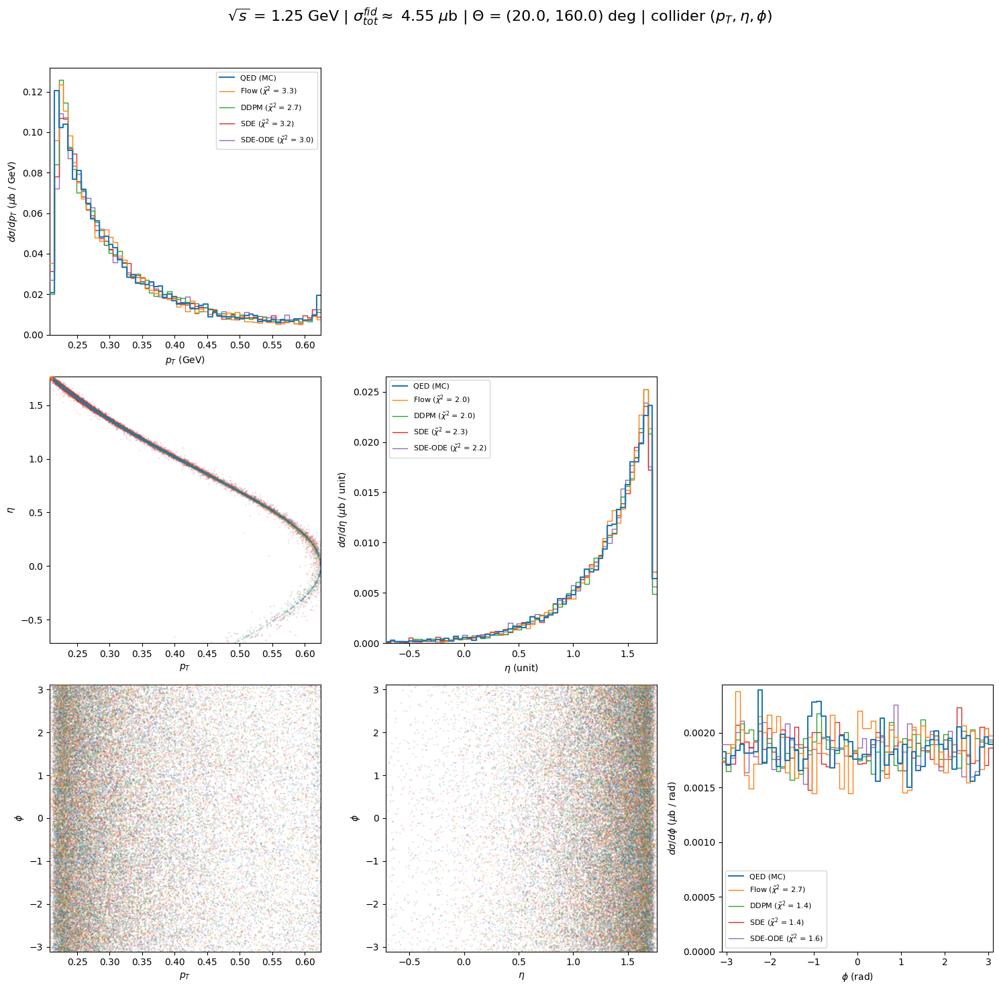

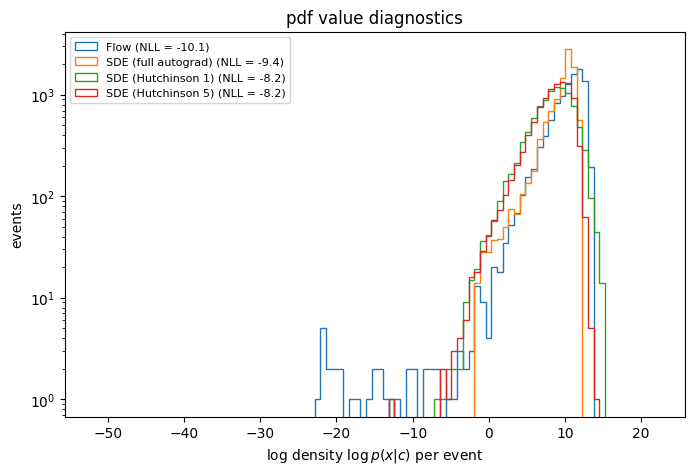

** INTERPOLATION / EXTRAPOLATION over the conditional input **
Generating 10000 events for sqrt(s) = 1.38 GeV
QED (MC): 1282.2 kHz
Flow: 539.4 kHz
DDPM: 17.8 kHz
SDE: 15.6 kHz
SDE (ODE): 17.9 kHz


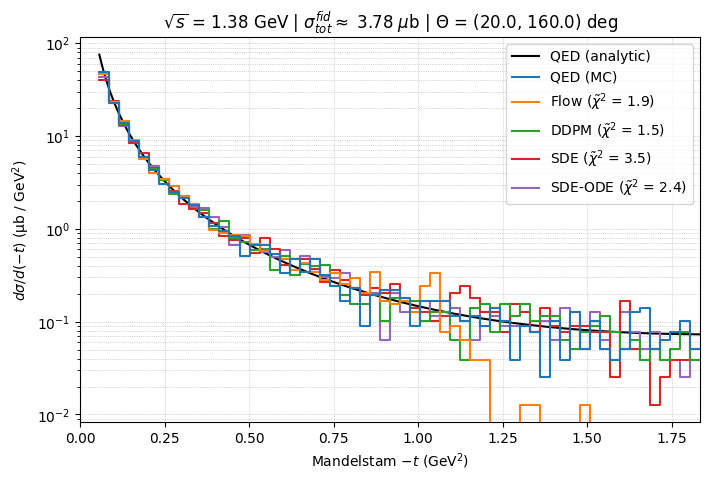

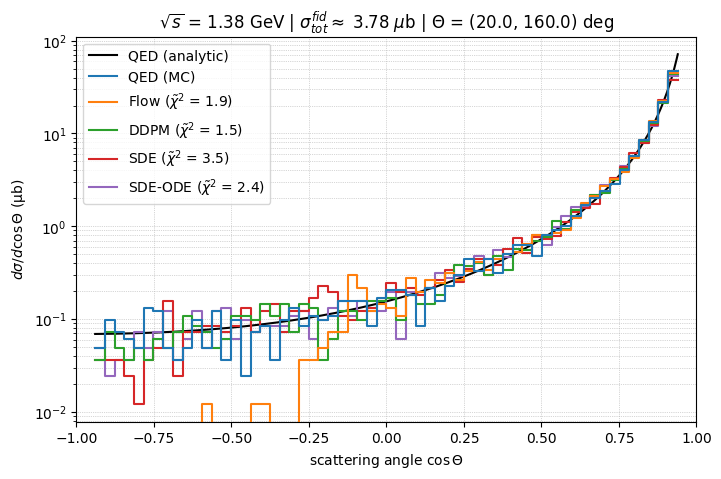

Flow logprob: 585.2 kHz
SDE logprob (exact grad): 35.3 kHz
SDE logprob (Hutchinson 1): 59.5 kHz
SDE logprob (Hutchinson 5): 17.2 kHz


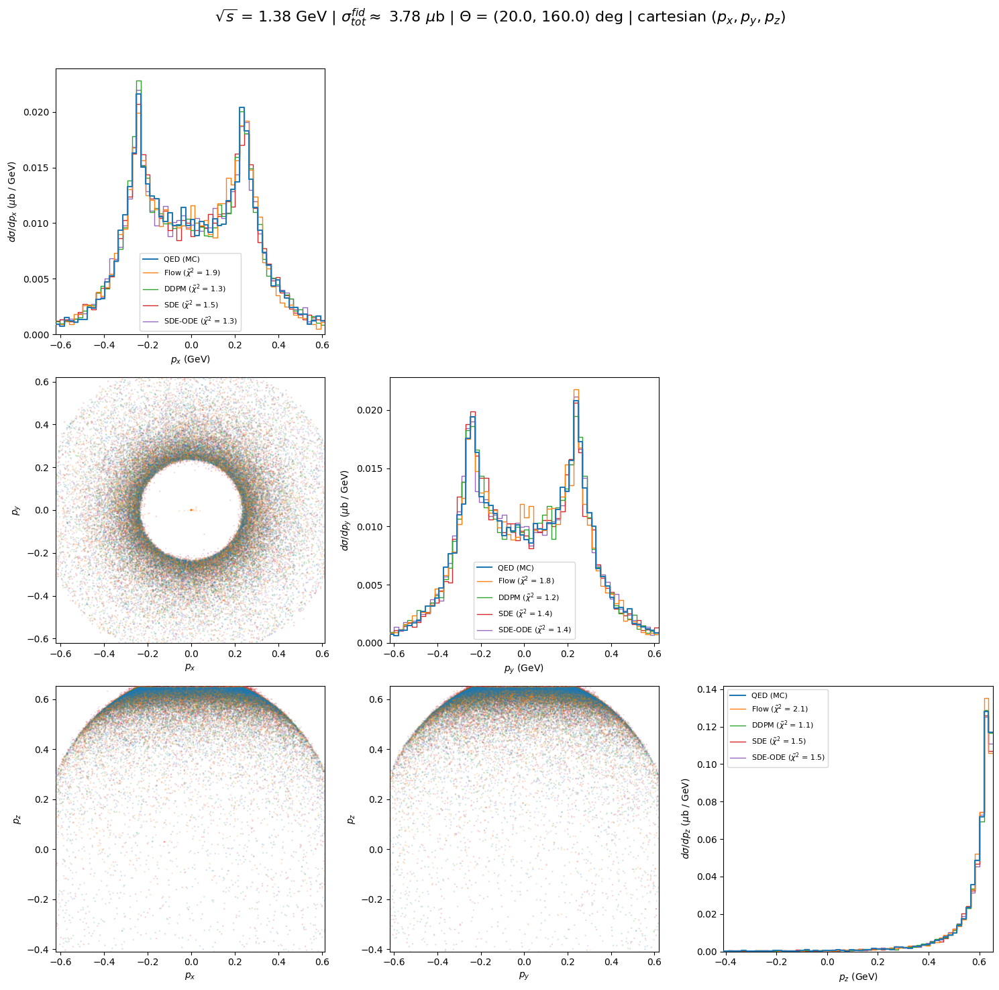

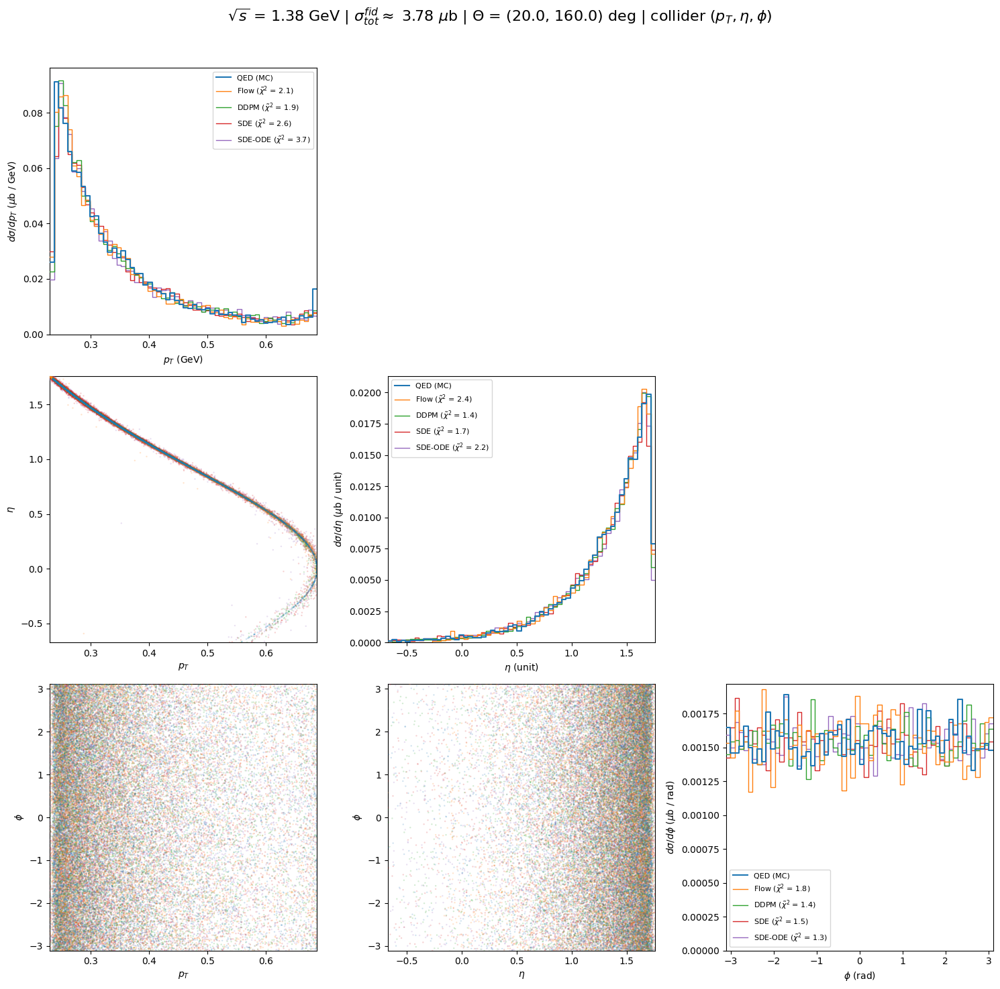

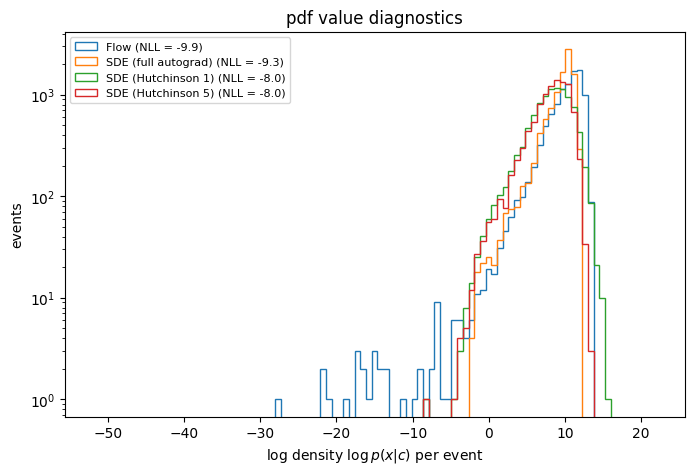

Generating 10000 events for sqrt(s) = 1.50 GeV
QED (MC): 1273.0 kHz
Flow: 535.7 kHz
DDPM: 17.8 kHz
SDE: 15.5 kHz
SDE (ODE): 17.9 kHz


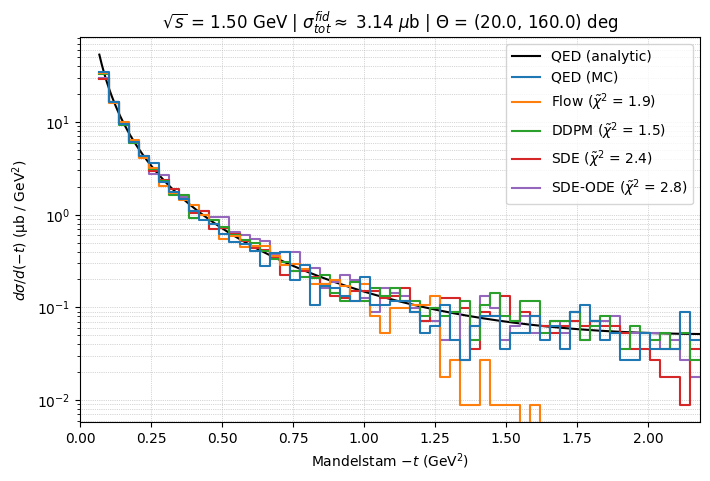

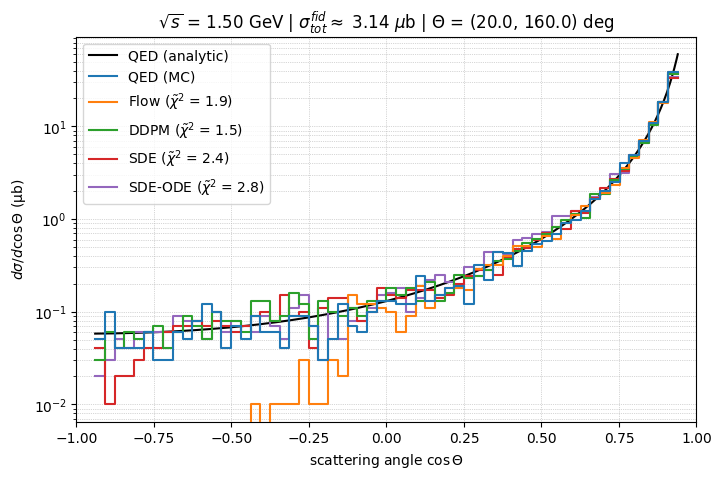

Flow logprob: 587.5 kHz
SDE logprob (exact grad): 35.8 kHz
SDE logprob (Hutchinson 1): 59.6 kHz
SDE logprob (Hutchinson 5): 17.4 kHz


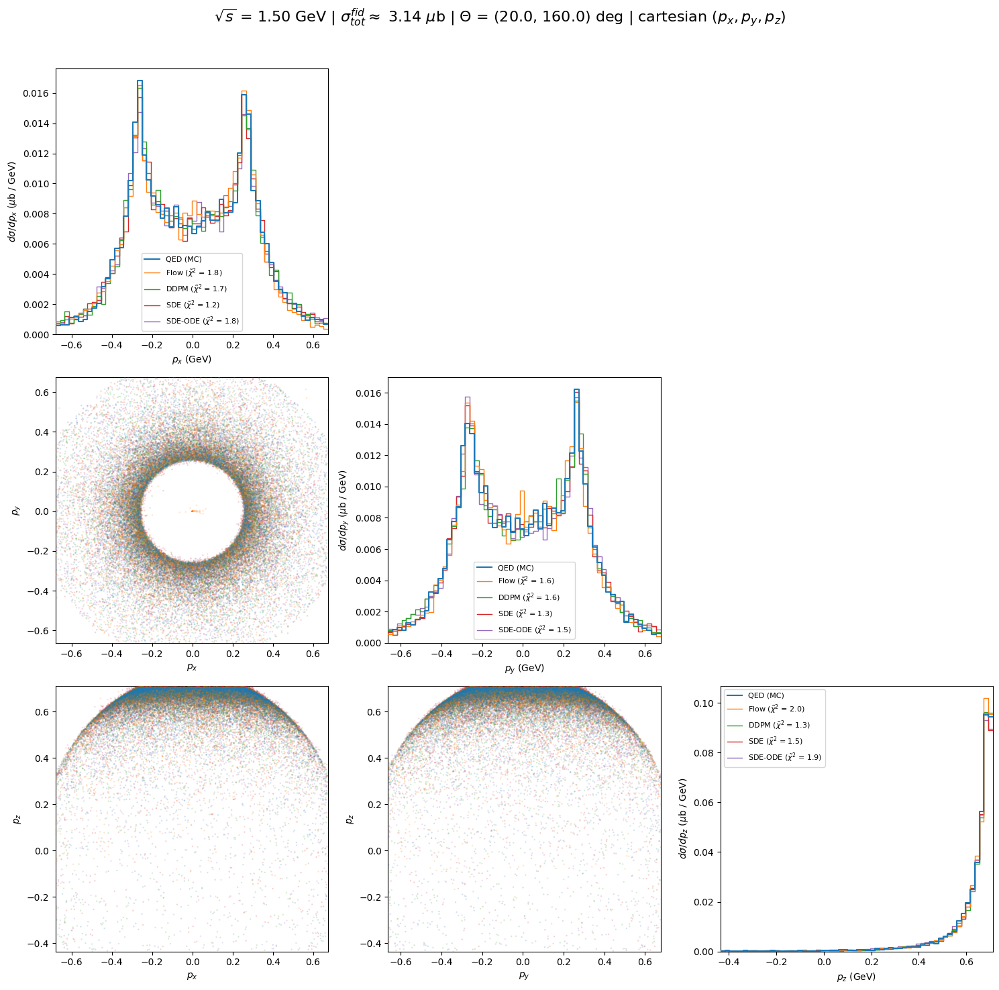

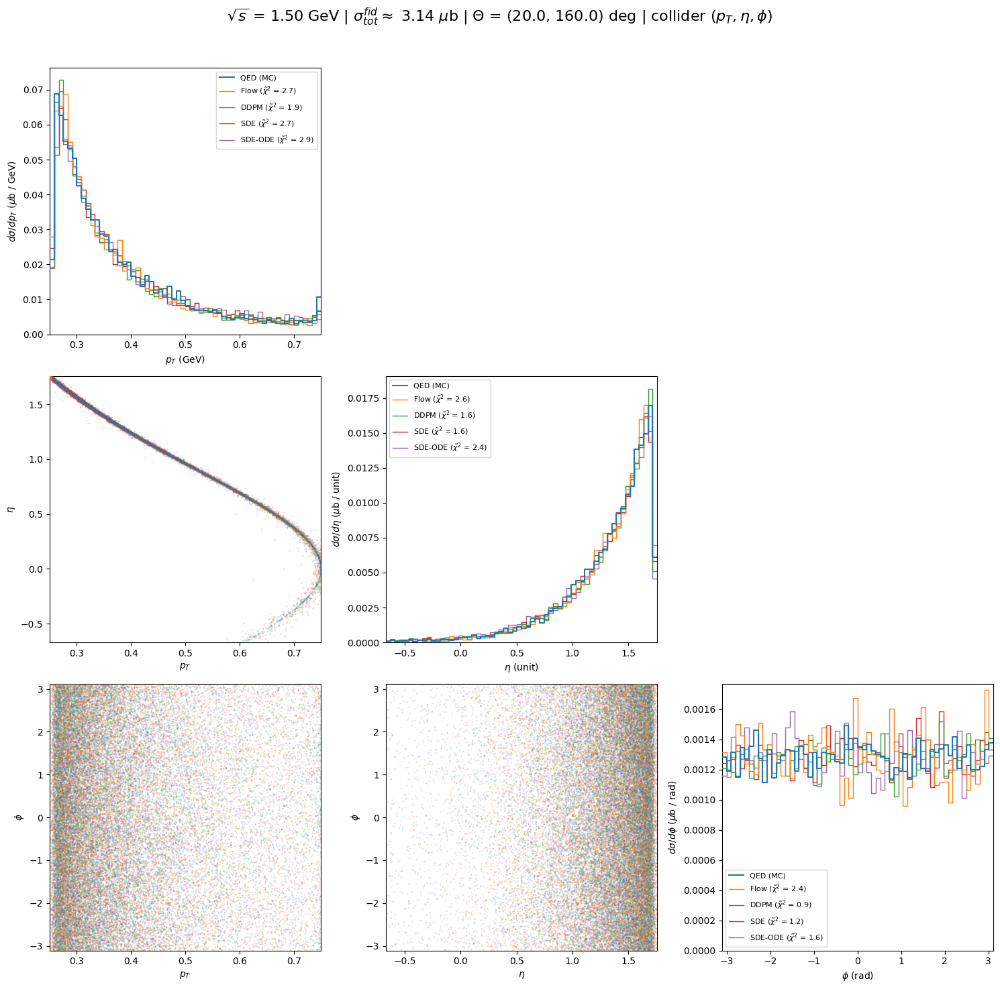

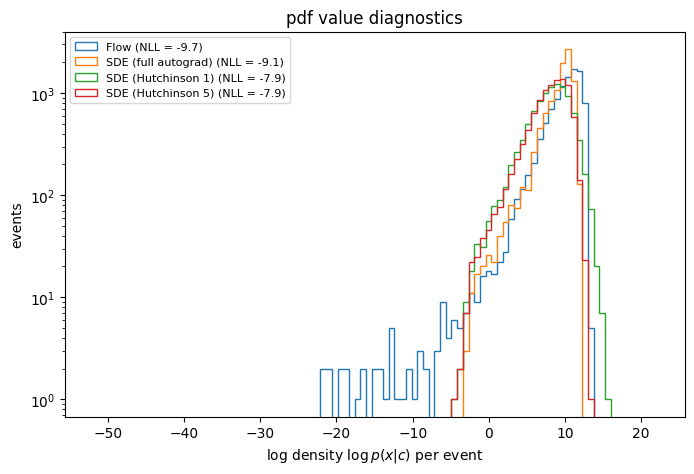

** INTERPOLATION / EXTRAPOLATION over the conditional input **
Generating 10000 events for sqrt(s) = 1.62 GeV
QED (MC): 1273.9 kHz
Flow: 542.3 kHz
DDPM: 17.9 kHz
SDE: 15.6 kHz
SDE (ODE): 18.0 kHz


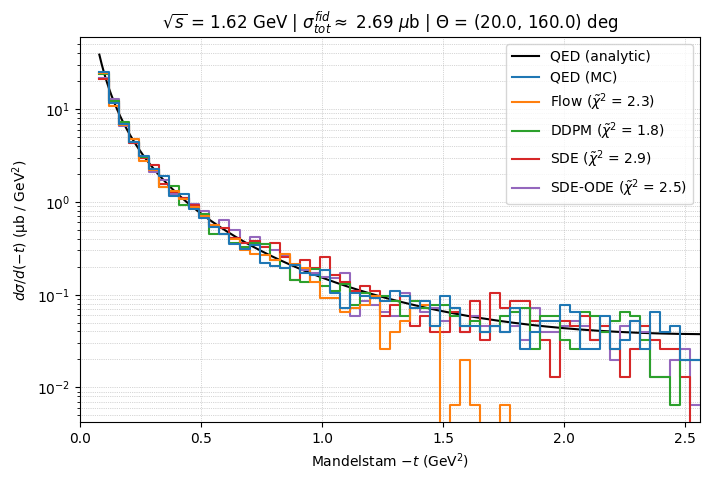

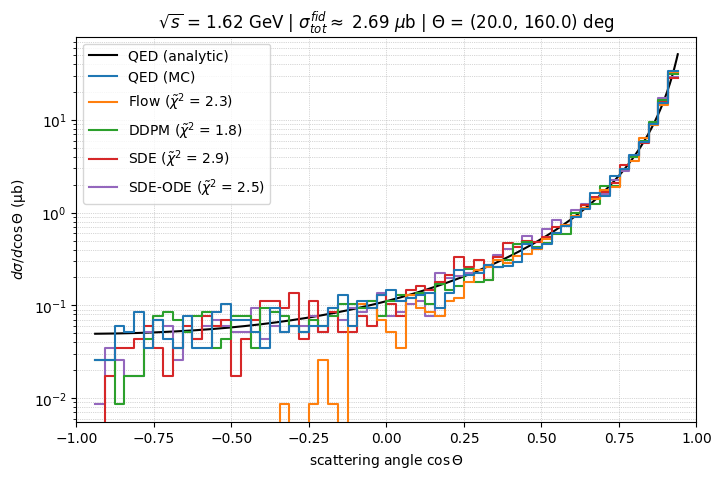

Flow logprob: 583.4 kHz
SDE logprob (exact grad): 35.6 kHz
SDE logprob (Hutchinson 1): 59.3 kHz
SDE logprob (Hutchinson 5): 17.4 kHz


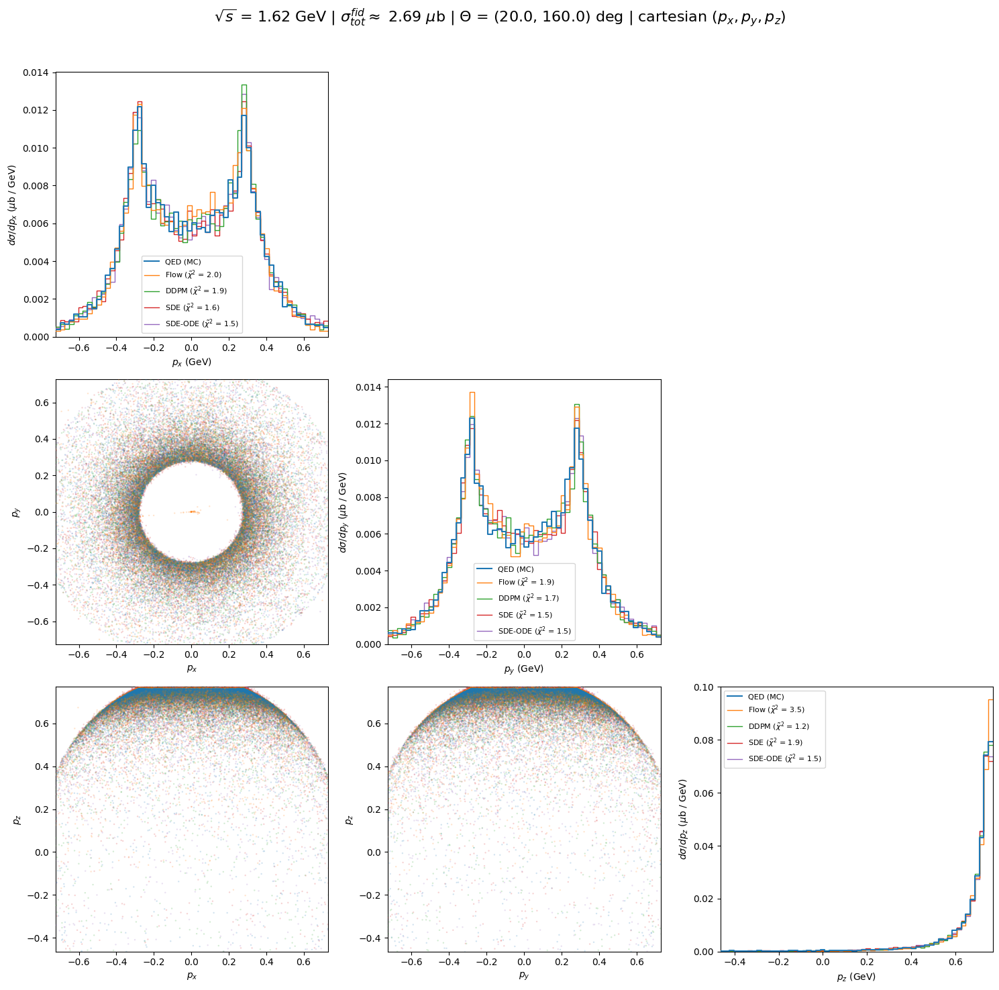

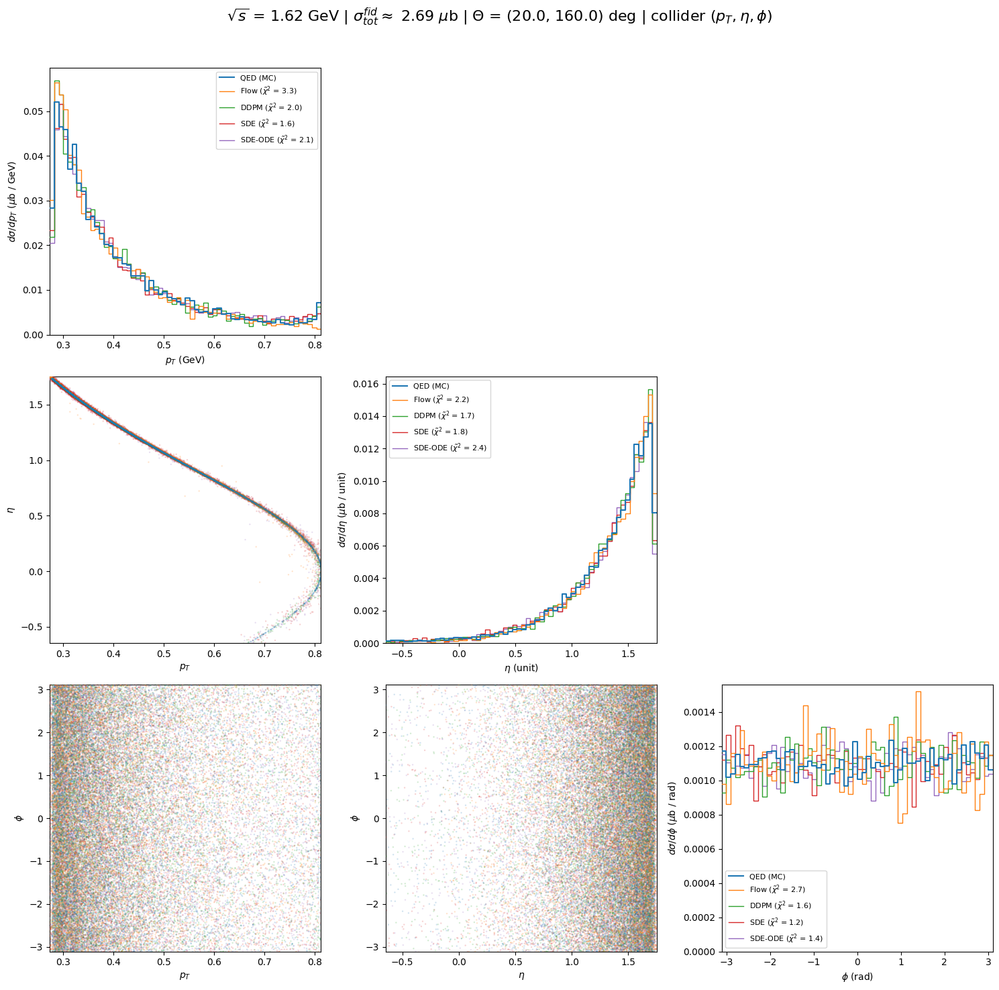

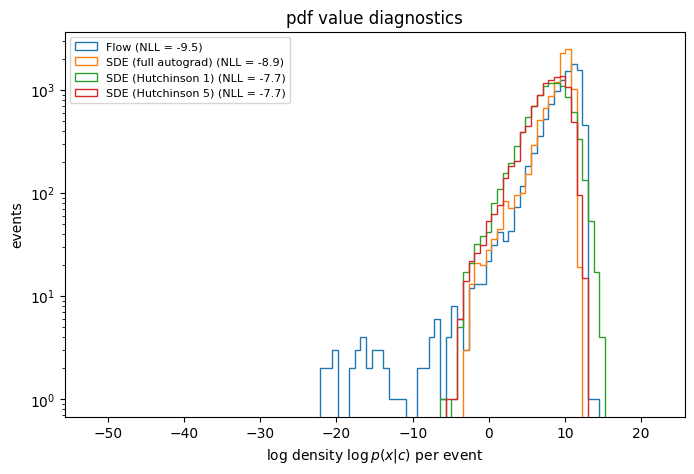

Generating 10000 events for sqrt(s) = 1.75 GeV
QED (MC): 1238.9 kHz
Flow: 533.7 kHz
DDPM: 17.8 kHz
SDE: 15.6 kHz
SDE (ODE): 18.0 kHz


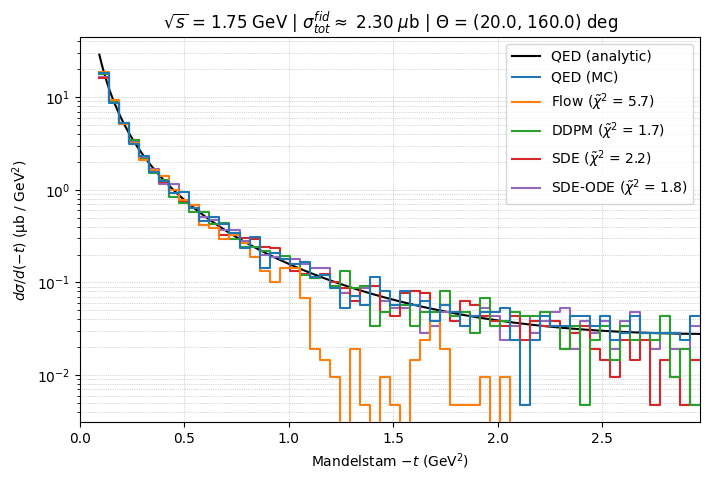

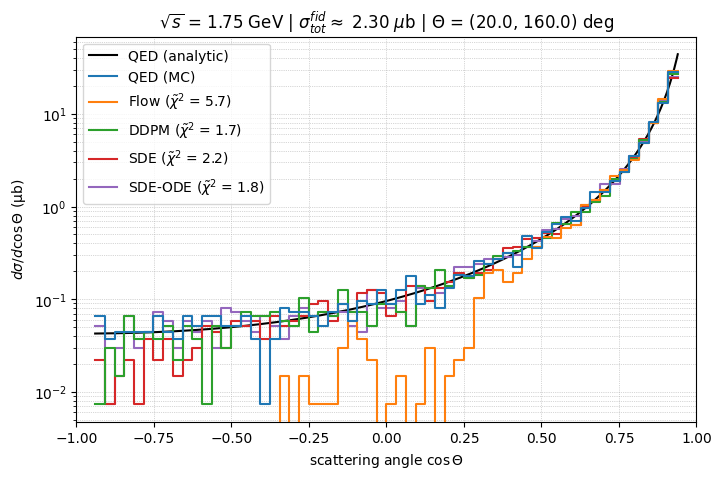

Flow logprob: 590.2 kHz
SDE logprob (exact grad): 35.3 kHz
SDE logprob (Hutchinson 1): 59.4 kHz
SDE logprob (Hutchinson 5): 17.3 kHz


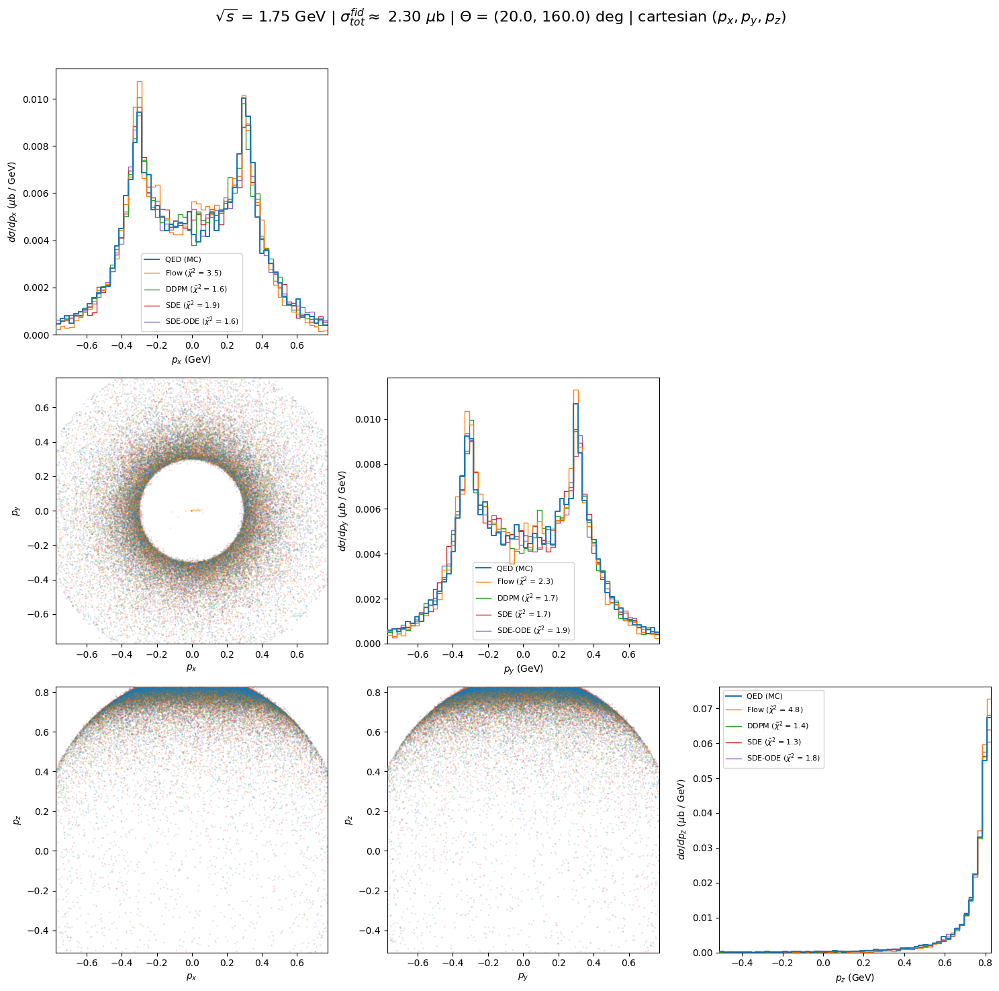

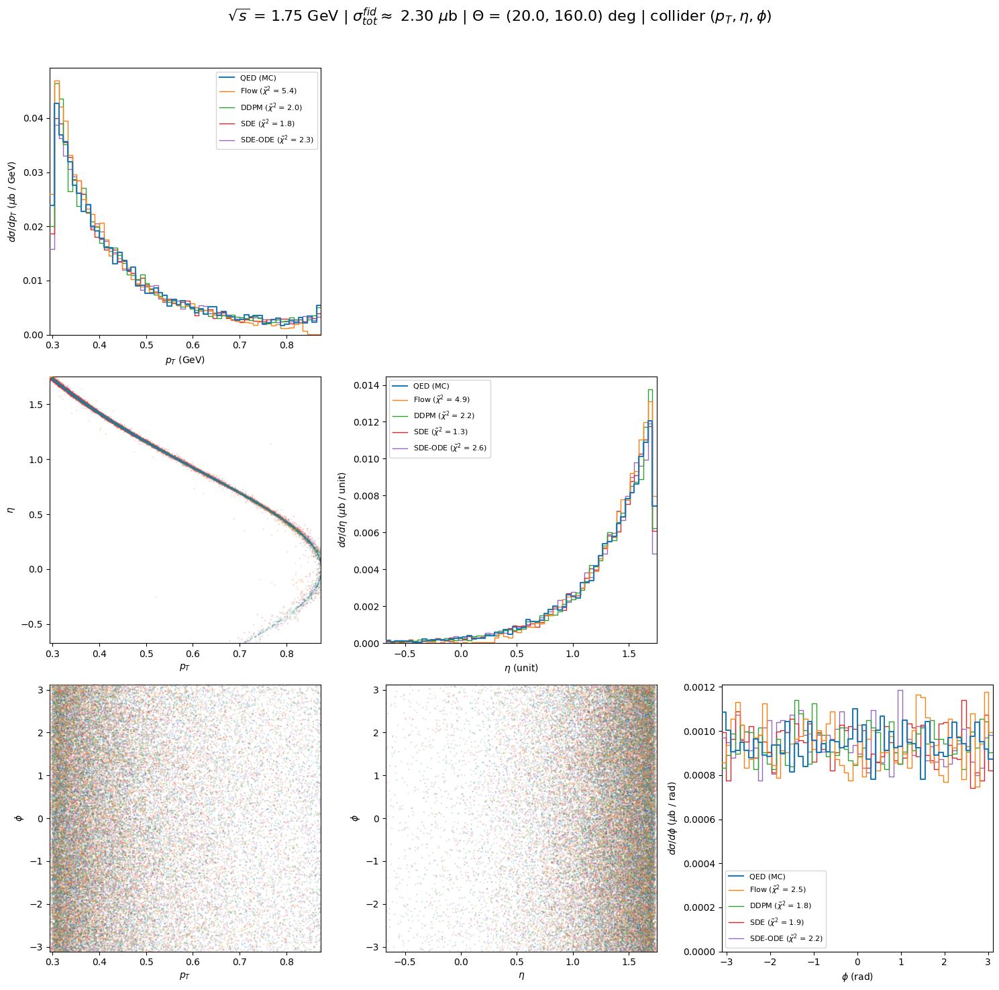

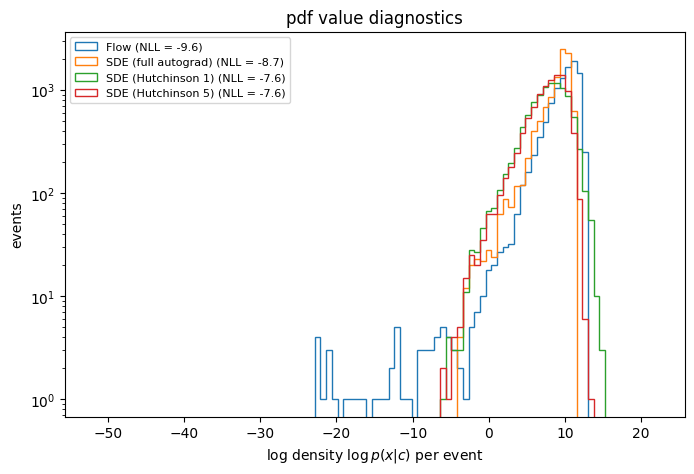

** INTERPOLATION / EXTRAPOLATION over the conditional input **
Generating 10000 events for sqrt(s) = 1.88 GeV
QED (MC): 1259.2 kHz
Flow: 538.3 kHz
DDPM: 17.8 kHz
SDE: 15.6 kHz
SDE (ODE): 18.0 kHz


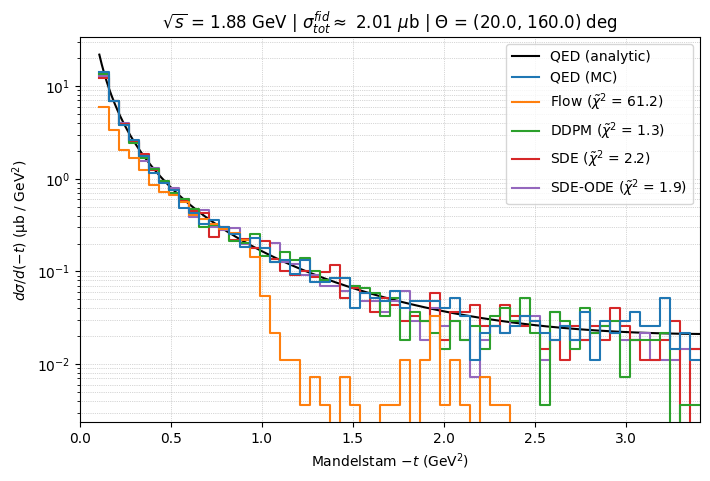

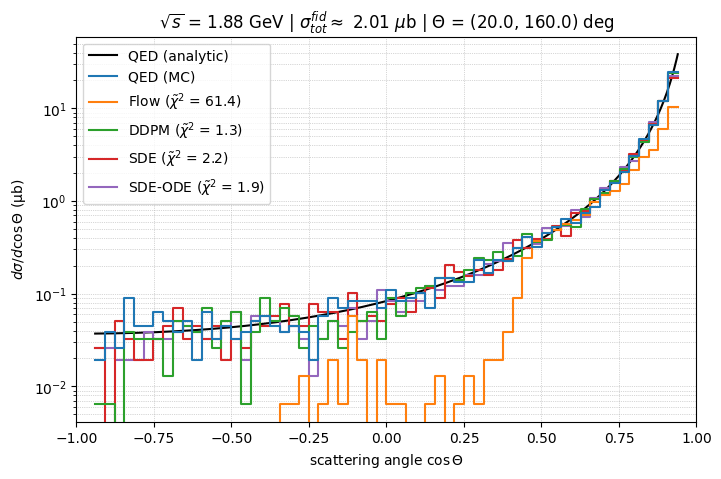

Flow logprob: 593.7 kHz
SDE logprob (exact grad): 35.5 kHz
SDE logprob (Hutchinson 1): 59.3 kHz
SDE logprob (Hutchinson 5): 17.3 kHz


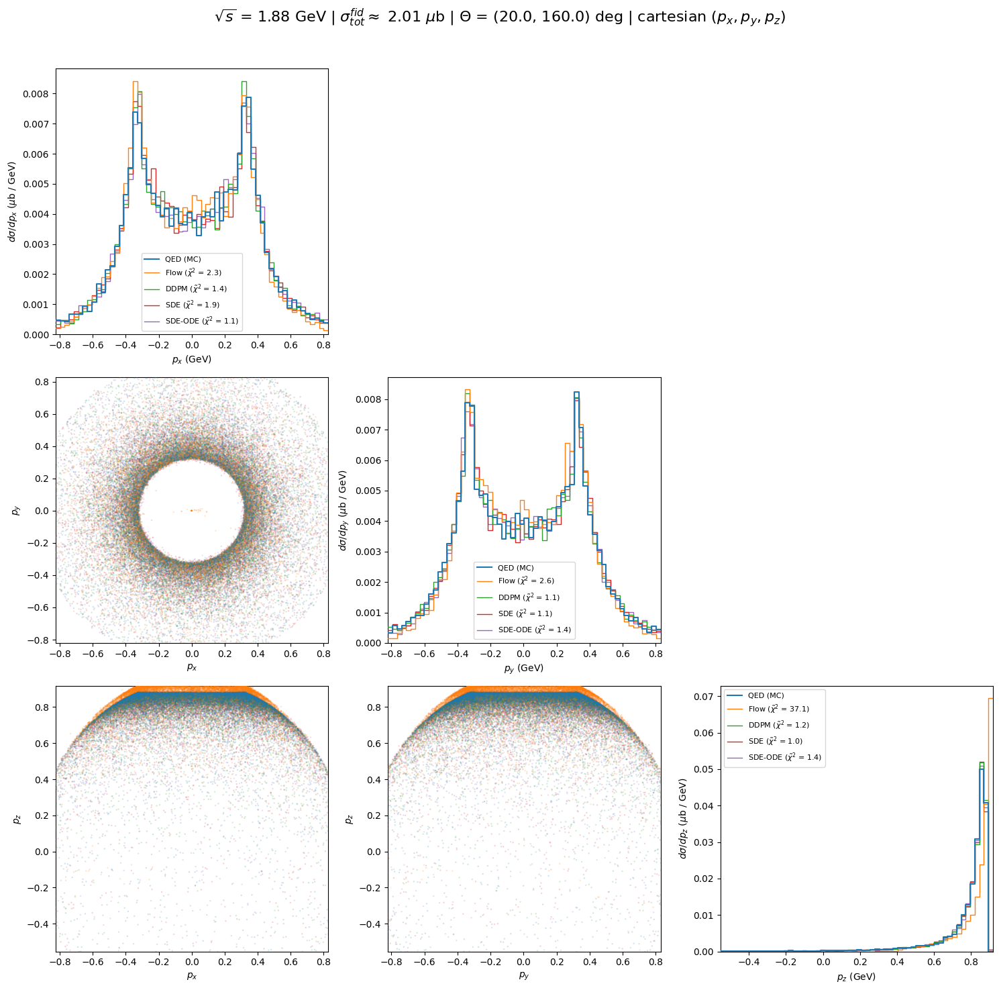

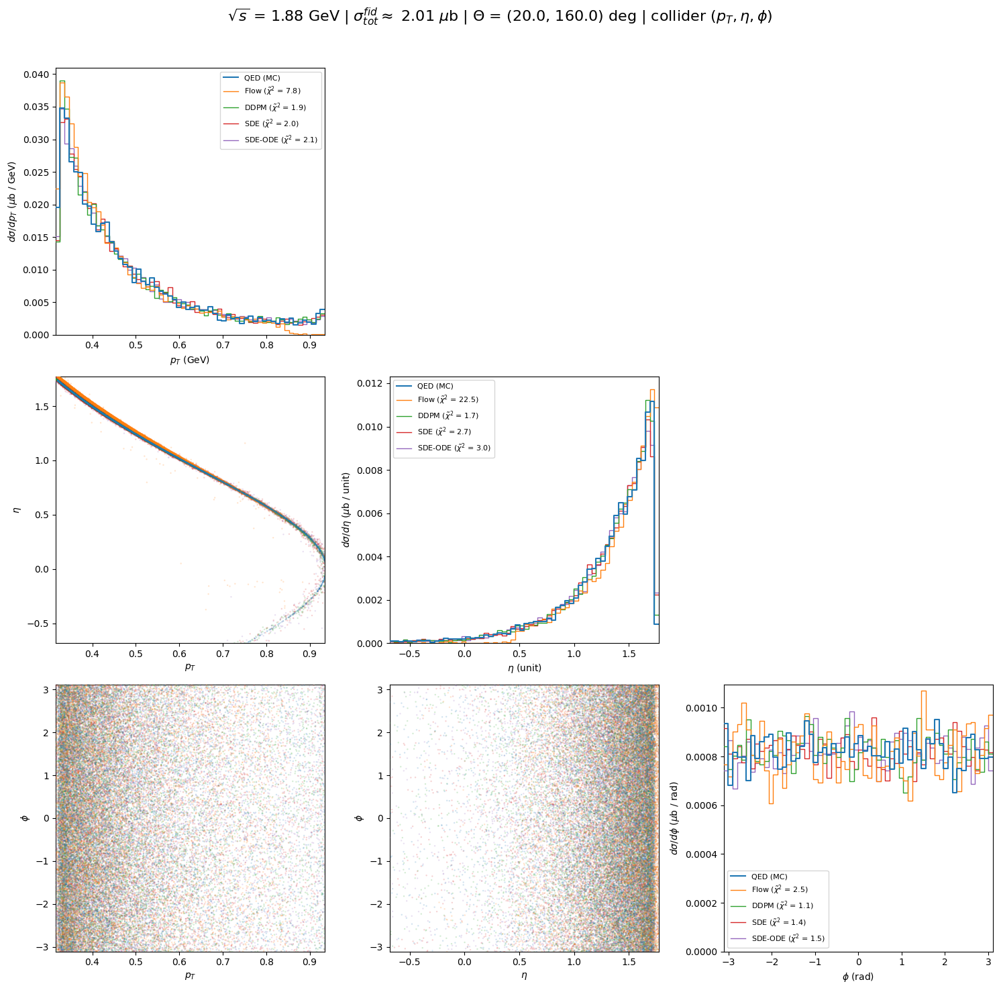

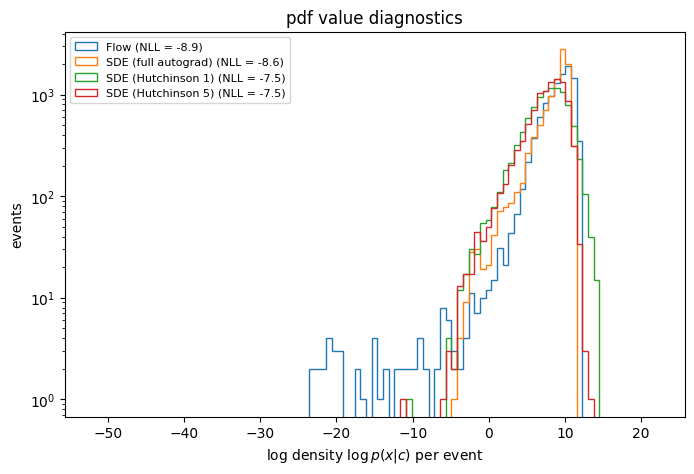

Generating 10000 events for sqrt(s) = 2.00 GeV
QED (MC): 1276.4 kHz
Flow: 538.9 kHz
DDPM: 17.8 kHz
SDE: 15.6 kHz
SDE (ODE): 18.0 kHz


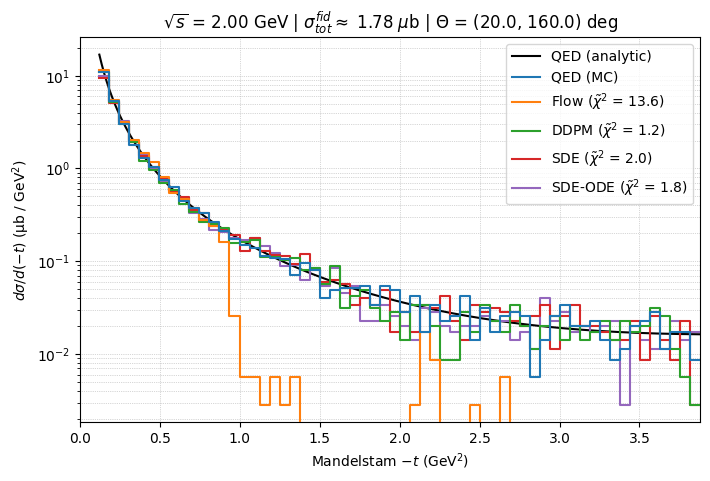

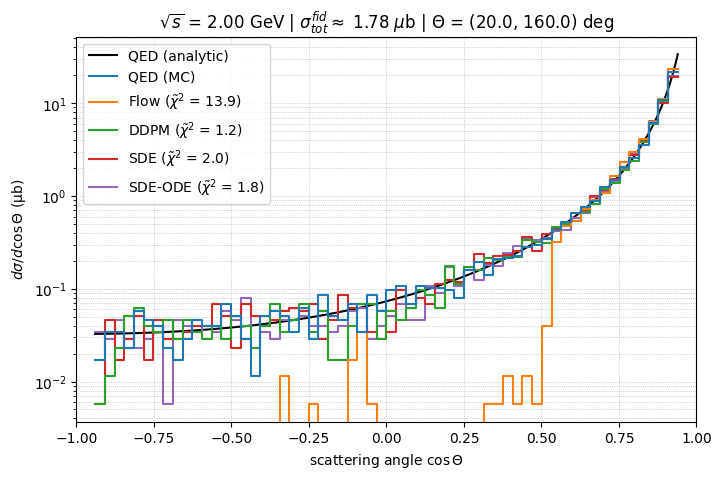

Flow logprob: 589.1 kHz
SDE logprob (exact grad): 35.5 kHz
SDE logprob (Hutchinson 1): 59.4 kHz
SDE logprob (Hutchinson 5): 17.3 kHz


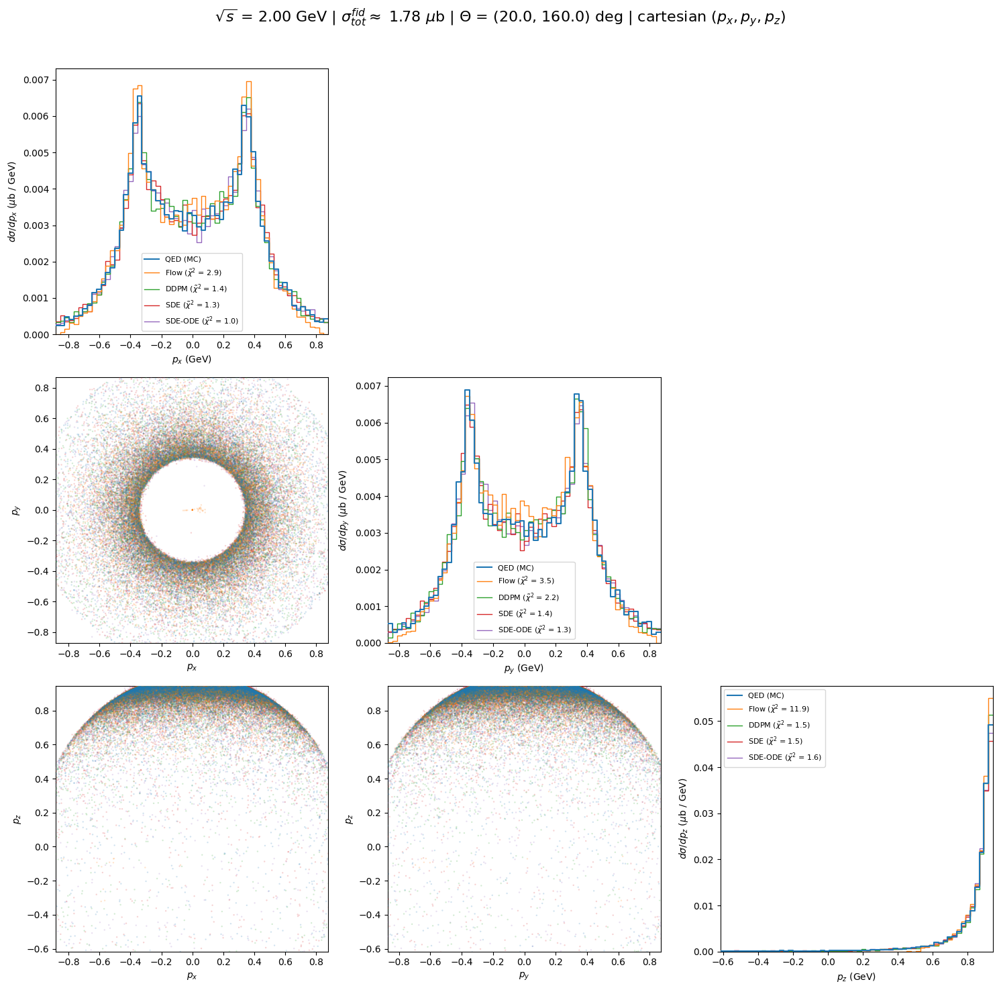

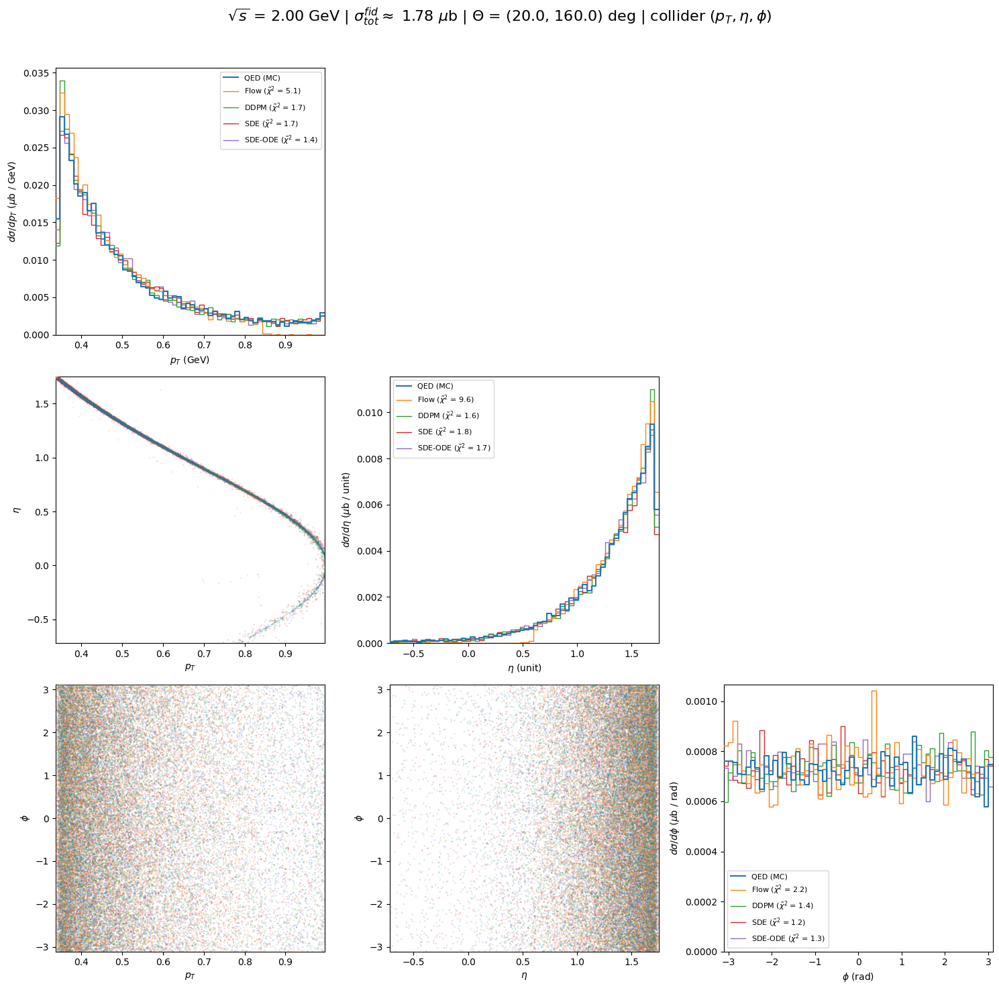

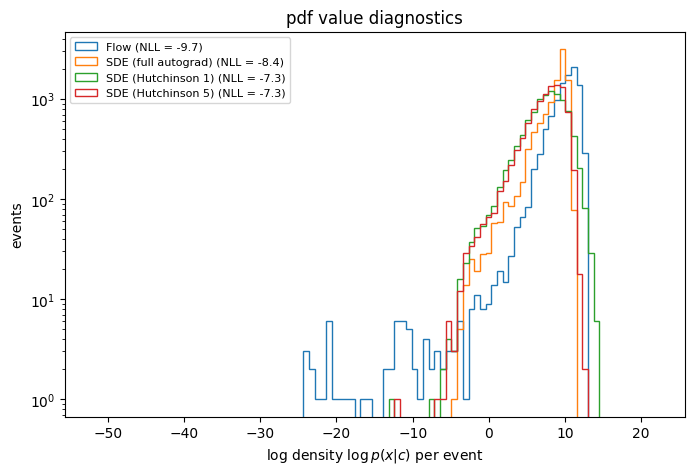

** INTERPOLATION / EXTRAPOLATION over the conditional input **
Generating 10000 events for sqrt(s) = 3.00 GeV
QED (MC): 1287.1 kHz
Flow: 538.7 kHz
DDPM: 17.8 kHz
SDE: 15.5 kHz
SDE (ODE): 18.0 kHz


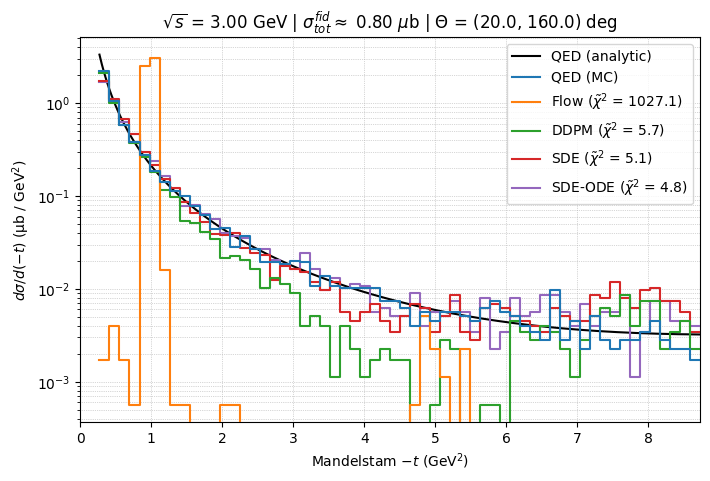

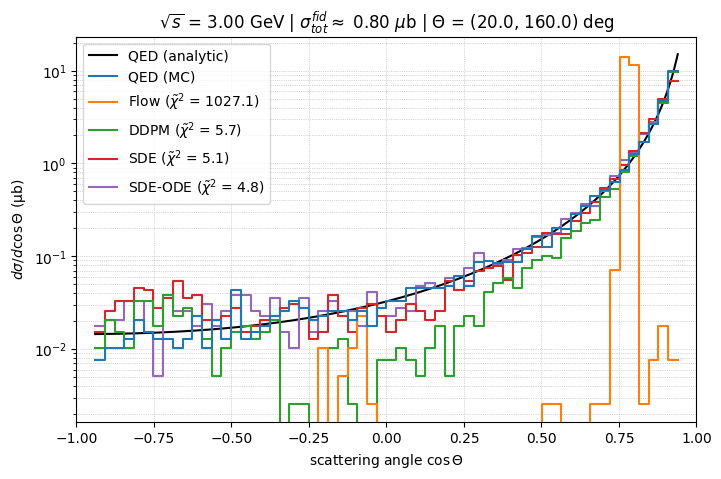

Flow logprob: 588.0 kHz
SDE logprob (exact grad): 35.3 kHz
SDE logprob (Hutchinson 1): 59.4 kHz
SDE logprob (Hutchinson 5): 17.2 kHz


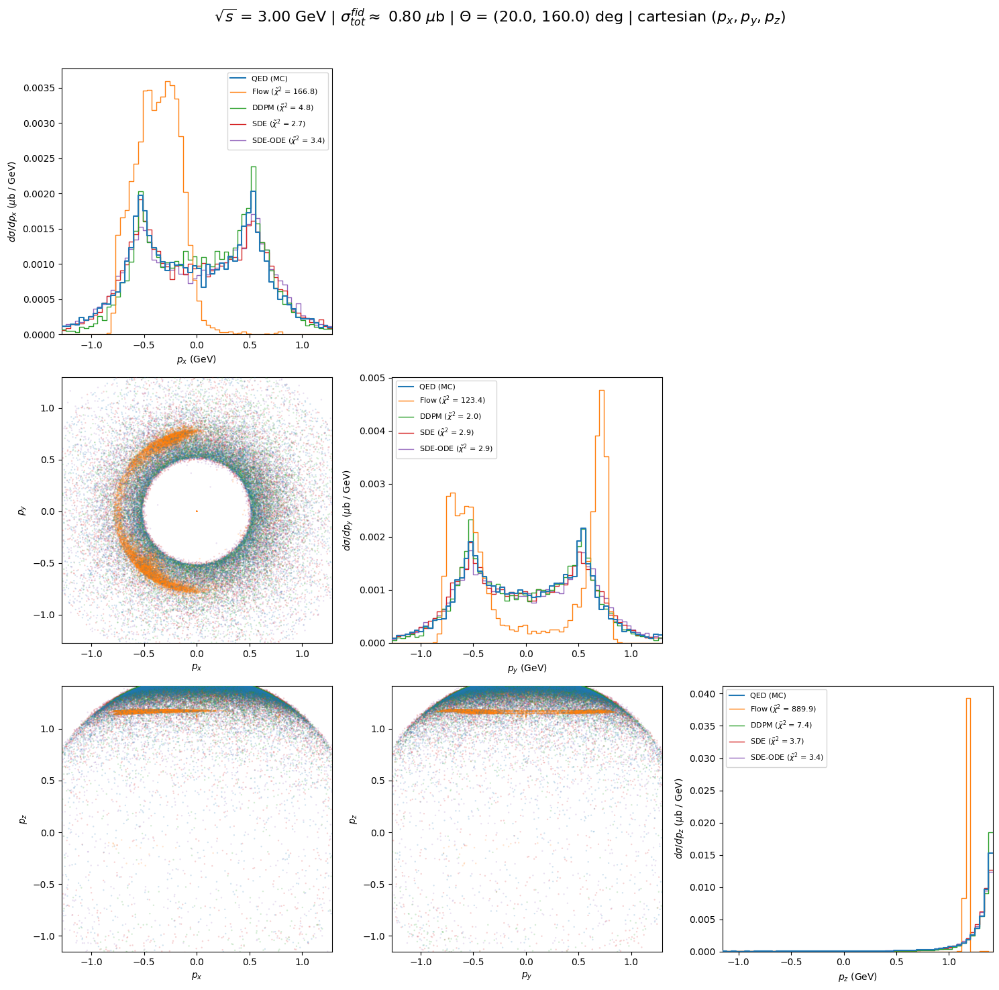

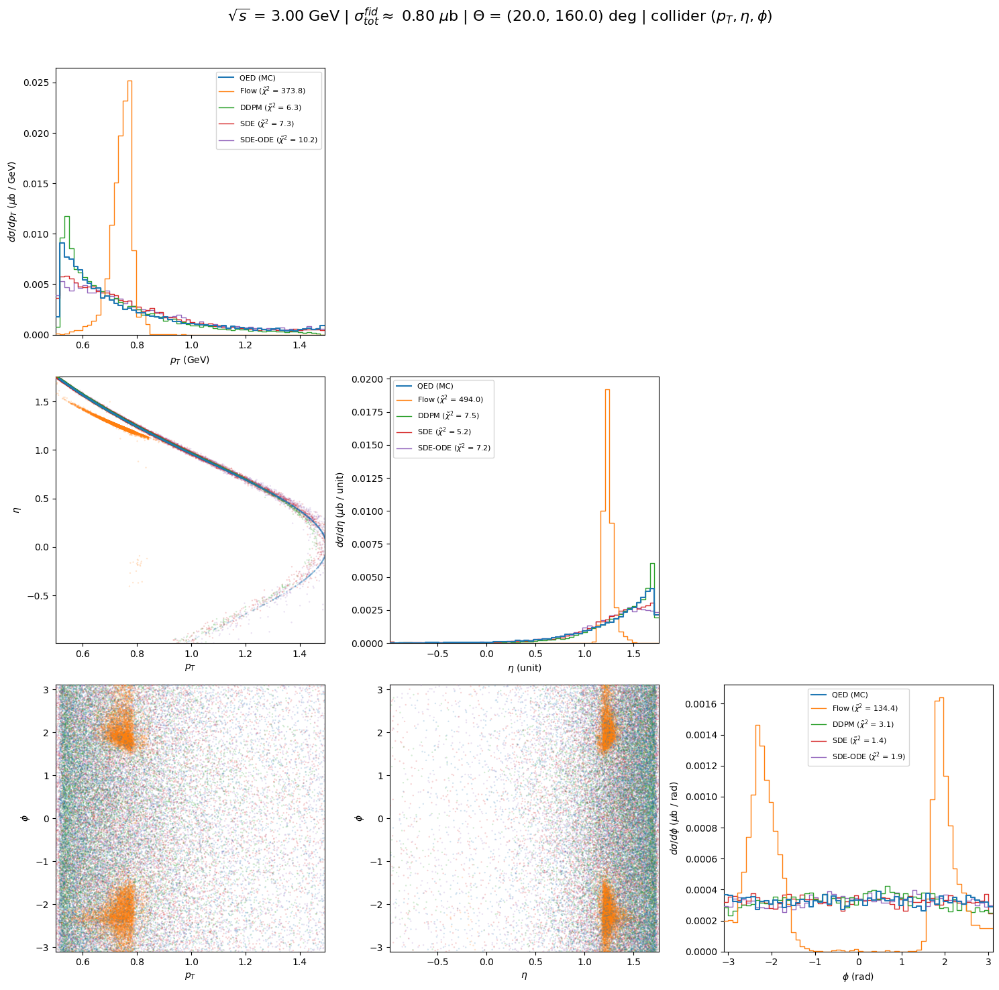

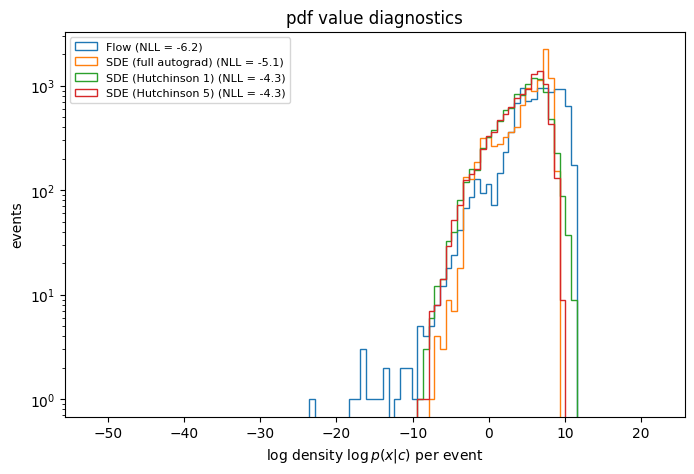

In [11]:
# Now visualize, this is fast

import matplotlib.pyplot as plt
from time import time
import copy

from xaims import visualize, qedgen

num_events = int(1e4)
nbins      = 60

# ---------------------------------------------------------------------------
# Create conditional variable sqrt(s) test values

sqrts_train = np.array(sqrts_train_values, dtype=float)
midpoints   = (sqrts_train[:-1] + sqrts_train[1:]) / 2 if len(sqrts_train_values) > 1 else np.array([])
outpoints   = np.array([sqrts_train.min()*0.75, sqrts_train.max()*1.5])
sqrts_vals  = np.sort(np.concatenate([sqrts_train, midpoints, outpoints]))
# ---------------------------------------------------------------------------

print(f"Original training set sqrt(s): {sqrts_train} (GeV)")
print(f"Inference test set sqrts(s): {sqrts_vals} (GeV) \n")

for sqrts in sqrts_vals:

    if sqrts not in sqrts_train:
        print('** INTERPOLATION / EXTRAPOLATION over the conditional input **')
    
    print(f'Generating {num_events} events for sqrt(s) = {sqrts:0.2f} GeV')
    
    s = sqrts**2
    
    # Use the limits as in the training data
    t_min = qedgen.costheta_to_t(costheta=np.cos(theta_max_fiducial), s=s)
    t_max = qedgen.costheta_to_t(costheta=np.cos(theta_min_fiducial), s=s)

    t_min = max(t_min, -(s - 4*qedgen.m_e**2)) # kinematic limit
    
    # ---------------------------------------------------------------------
    # 1) Generate MC
    tic = time()
    x_mc, xs_tot, xs_err, unweight_eff = qedgen.generator(num_events=num_events, sqrts=sqrts, t_min=t_min, t_max=t_max, theory=qedgen.Mode.QED_bhabha)
    print(f"QED (MC): {num_events / (time() - tic) / 1000:0.1f} kHz")
    
    # ---------------------------------------------------------------------
    # 2) Generate AI samples
    tic    = time()
    x_flow = sample_from_flow(num_events, cond=sqrts, device=device)
    print(f"Flow: {num_events / (time() - tic) / 1000:0.1f} kHz")
    
    tic    = time()
    x_ddpm = sample_from_ddpm(num_events, cond=sqrts, device=device)
    print(f"DDPM: {num_events / (time() - tic) / 1000:0.1f} kHz")
    
    tic   = time()
    x_sde = sample_from_sde(num_events,  cond=sqrts, device=device)
    print(f"SDE: {num_events / (time() - tic) / 1000:0.1f} kHz")
    
    tic   = time()
    x_sde_ode = sample_from_sde(num_events,  cond=sqrts, use_ode=True, device=device)
    print(f"SDE (ODE): {num_events / (time() - tic) / 1000:0.1f} kHz")
    
    # ---------------------------------------------------------------------
    # Comment out samples here for visualization purposes 
    
    x_samples = {
        "QED (MC)": x_mc,
        "Flow":     x_flow.cpu().numpy(),
        "DDPM":     x_ddpm.cpu().numpy(),
        "SDE":      x_sde.cpu().numpy(),
        "SDE-ODE":  x_sde_ode.cpu().numpy()
    }
    
    # Analyze
    visualize.analyze(x_samples=x_samples, s=s, t_min=t_min, t_max=t_max, xs_tot=xs_tot,
                      nbins=nbins, reference_key="QED (MC)", prc=[0.5, 99.5])
    
    # ---------------------------------------------------------------------
    # PDF value distribution diagnostics
    
    tic   = time()
    LL_flow = logprob_flow(x_flow, cond=sqrts, device=device)
    print(f"Flow logprob: {num_events / (time() - tic) / 1000:0.1f} kHz")
    
    tic   = time()
    LL_sde_full = logprob_sde(torch.as_tensor(x_mc, dtype=torch.float32, device=device), cond=sqrts, steps=100, exact=True, device=device)
    print(f"SDE logprob (exact grad): {num_events / (time() - tic) / 1000:0.1f} kHz")
    
    tic   = time()
    LL_sde_hutch1 = logprob_sde(x_sde, cond=sqrts, steps=100, exact=False, n_hutchinson=1, device=device)
    print(f"SDE logprob (Hutchinson 1): {num_events / (time() - tic) / 1000:0.1f} kHz")
    
    tic   = time()
    LL_sde_hutch5 = logprob_sde(x_sde, cond=sqrts, steps=100, exact=False, n_hutchinson=5, device=device)
    print(f"SDE logprob (Hutchinson 5): {num_events / (time() - tic) / 1000:0.1f} kHz")
    
    # Clip outliers (make histogram binning such that the last bin matches)
    LL_flow       = torch.clip(LL_flow,       -50, 20).detach().cpu().numpy()
    LL_sde_full   = torch.clip(LL_sde_full,   -50, 20).detach().cpu().numpy()
    LL_sde_hutch1 = torch.clip(LL_sde_hutch1, -50, 20).detach().cpu().numpy()
    LL_sde_hutch5 = torch.clip(LL_sde_hutch5, -50, 20).detach().cpu().numpy()
    
    bins   = np.linspace(-52, 22, 100)
    fig,ax = plt.subplots(figsize=(8,5))
    
    plt.hist(LL_flow,       bins=bins, histtype='step', label=f'Flow (NLL = {-np.mean(LL_flow):0.1f})')
    plt.hist(LL_sde_full,   bins=bins, histtype='step', label=f'SDE (full autograd) (NLL = {-np.mean(LL_sde_full):0.1f})')
    plt.hist(LL_sde_hutch1, bins=bins, histtype='step', label=f'SDE (Hutchinson 1) (NLL = {-np.mean(LL_sde_hutch1):0.1f})')
    plt.hist(LL_sde_hutch5, bins=bins, histtype='step', label=f'SDE (Hutchinson 5) (NLL = {-np.mean(LL_sde_hutch5):0.1f})')
    
    plt.xlabel('log density $\\log p(x|c)$ per event')
    plt.ylabel('events')
    plt.yscale('log')
    plt.legend(fontsize=8)
    plt.title('pdf value diagnostics')
    plt.show()


<br>

---

## ** Exercise: Higher dimensional two sample comparison **

In order to compare if the correlation structure is also correct (not just 1D marginals), some possible approaches are:

- Exact Wasserstein distance (optimal transport cost)
- Sliced Wasserstein distance (approximated "random projections")
- Train a classifier to separate between two datasets (BCE loss) with equal training sample class balance, produce a ROC-curve, integrate the AUC value

Python Optimal Transport package: <a href="https://pythonot.github.io">pythonot.github.io</a>

**Obtaining Frequentist p-value estimate:**

To estimate the null distribution $H_0$ of a chosen test statistic (e.g., the Wasserstein distance), it is typically necessary to use resampling-based methods such as permutation tests, Efron's bootstrap (resampling with replacement), or other Monte Carlo approach. These methods allow for an empirical approximation of the sampling distribution under the null hypothesis, from which a $p$-value can be computed by evaluating how extreme the observed test statistic is relative to the null distribution.

Our null hypothesis $H_0$: *Both samples (QED MC and AI generated) come from the same distribution.*

**Task 1**: Implement Sliced and Exact Wasserstein distance comparison (you can use POT library) and the resampling based $p$-value procedure.

In [1]:
# Implement here.
# 
# import ot # POT library
# 
# Sliced
# distance = ot.sliced.sliced_wasserstein_distance(X_a, X_b, n_projections=50, p=2)
# 
# Exact Wasserstein
# M = ot.dist(X_a, X_b)
# distance = ot.emd2(a, b, M)
# 
# p-value procedure
# ...
# 

**Task 2**: Write down the basic theory behind Wasserstein metric, i.e. the formulas and some short description.

In [ ]:
# Write here

**Task 3**: With this new code, produce high-dimensional two sample comparison tables at different conditional energies (rows) and for different AI models (columns).

In [2]:
# Implement here.

<br>

---
## Check your knowledge

1. **Which loss function was used for the flow and for the diffusion models?**
2. **How are DDPM and SDE-VP related?**
4. **What is the difference between stochastic and ODE sampling methods with SDE diffusion?**
6. **How did we actually obtain density (PDF) values with the diffusion model?**
7. **Both flow and SDE models may give sometimes extremely small evaluated log density values. What are these outliers?**
8. **How were the interpolation and extrapolation results over the conditional $c$?**
9. **Could you easily improve the architectures, diffusion schedules / training methods or sampling algorithms?**

<br>

